In [1]:
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from matplotlib.gridspec import GridSpec, GridSpecFromSubplotSpec
import matplotlib.image as mpimg
import pandas as pd
import os
import umap
import seaborn as sns
# PATHs
PROJECT_DATA_PATH='//home/bule/projects/MVTec_Visualizer/data/mvtec_anomaly_detection'
LOG_DIR= '/home/bule/projects/MVTec_Visualizer/tensorboard_logs'

2023-12-07 15:23:42.769931: I tensorflow/core/util/port.cc:111] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-12-07 15:23:42.771188: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-12-07 15:23:42.789815: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-12-07 15:23:42.789835: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-12-07 15:23:42.789848: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to regi

In [2]:
FILENAME = 'MVTEC_CLIP_embeddings_df'
df = pd.read_pickle(os.path.join(PROJECT_DATA_PATH,FILENAME+'.pkl'))
image_paths=[pts[1:]for pts in df.index]
df = df.set_index(pd.Index(image_paths))

In [3]:
anomaly_categories = {
    'bottle': ['broken_large', 'broken_small', 'contamination'],
    'cable': ['bent_wire', 'cable_swap', 'combined', 'cut_inner_insulation', 'cut_outer_insulation', 'missing_cable', 'missing_wire', 'poke_insulation'],
    'capsule': ['crack', 'faulty_imprint', 'poke', 'scratch','squeeze'],
    'carpet': ['color', 'cut', 'hole', 'metal_contamination', 'thread'],
    'grid': ['bent', 'broken', 'glue', 'metal_contamination', 'thread'],
    'hazelnut': ['crack', 'cut', 'hole', 'print'],
    'leather': ['color', 'cut', 'fold', 'glue', 'poke'],
    'metal_nut': ['bent', 'color', 'flip', 'scratch'],
    'pill': ['color', 'combined','contamination', 'crack', 'faulty_imprint', 'pill_type','scratch'],
    'screw': ['manipulated_front', 'scratch_head', 'scratch_neck','thread_side', 'thread_top'],
    'tile': ['crack', 'glue_strip', 'gray_stroke', 'oil','rough'],
    'toothbrush': ['defective'],
    'transistor': ['bent_lead', 'cut_lead', 'damaged_case', 'misplaced'],
    'wood': ['color', 'combined', 'hole', 'liquid', 'scratch'],
    'zipper': ['broken_teeth', 'combined','fabric_border', 'fabric_interior','split_teeth','rough', 'squeezed_teeth']
}


## TSNE

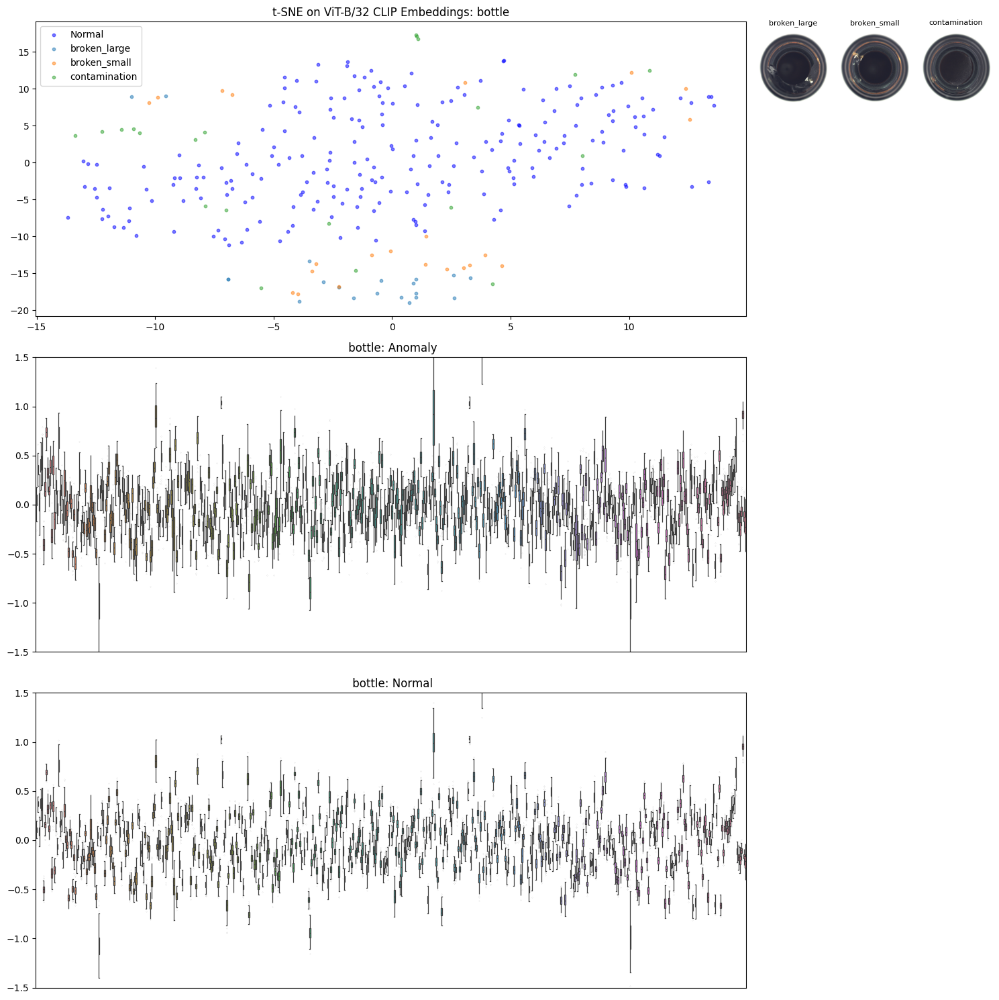

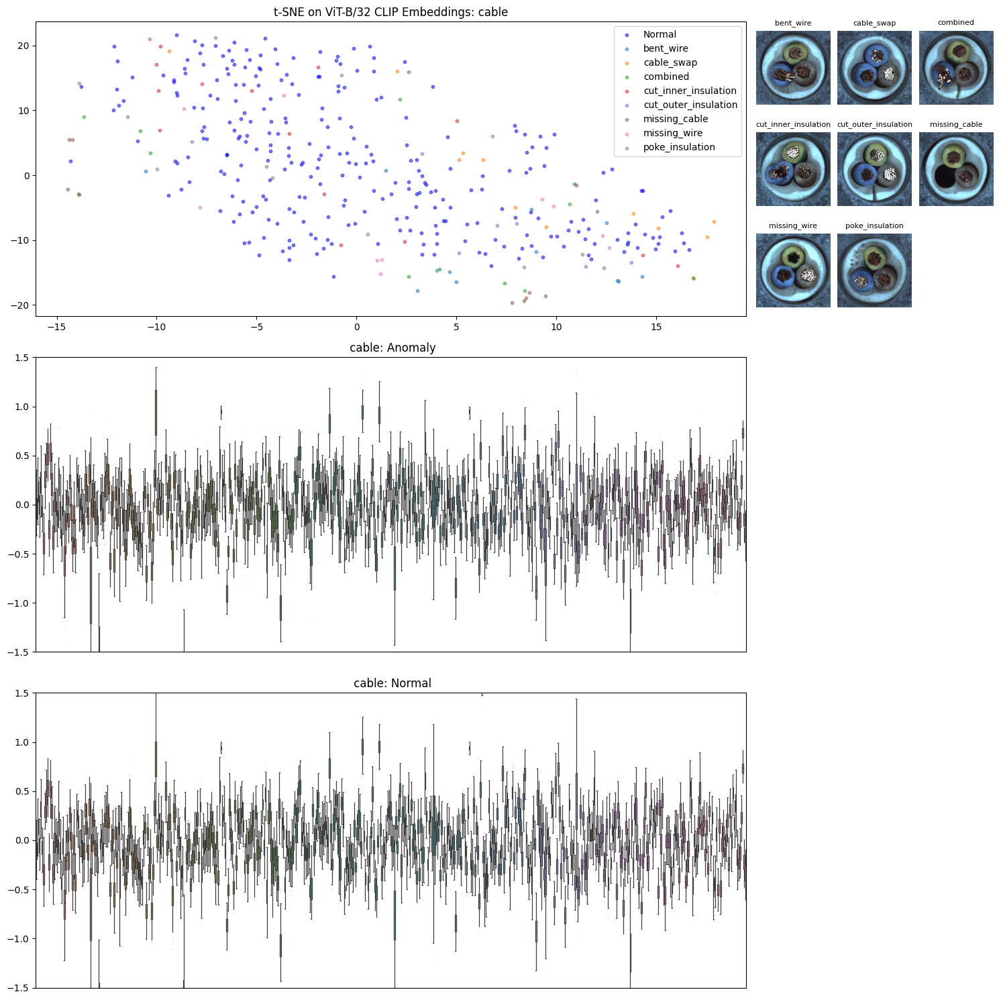

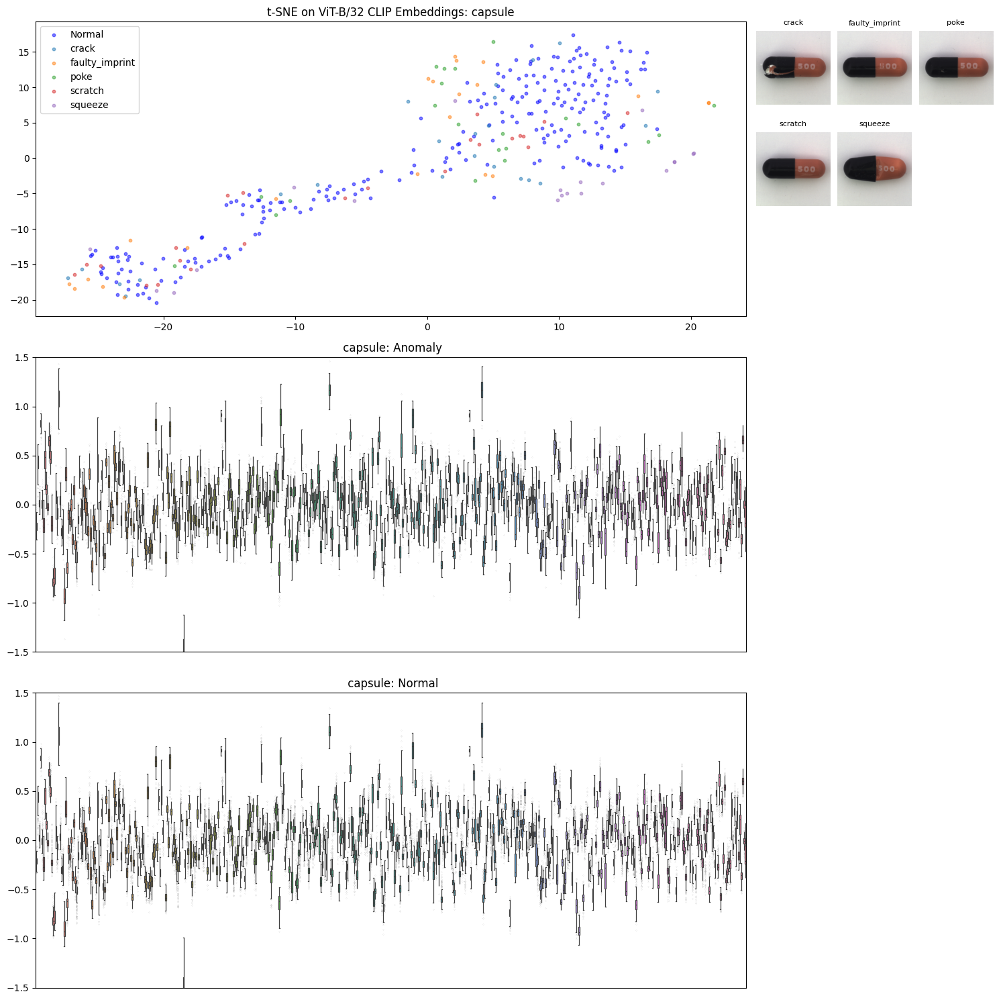

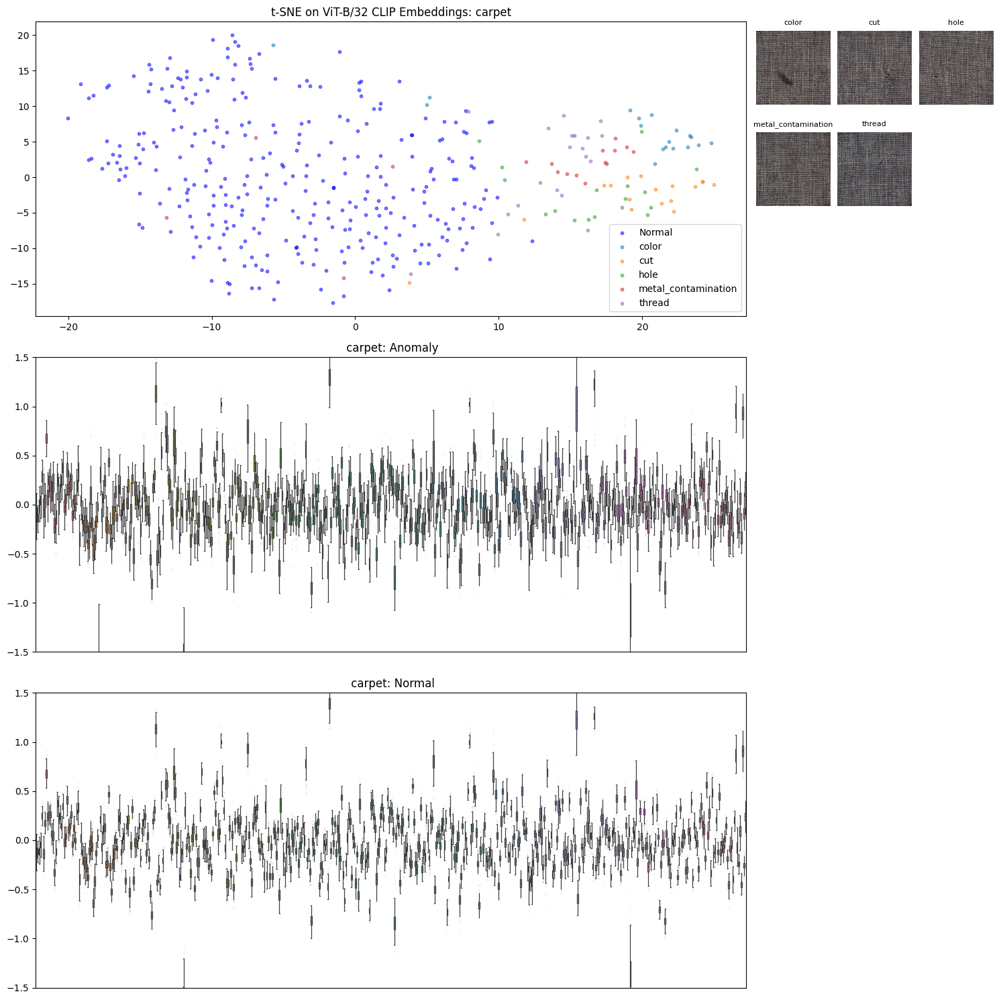

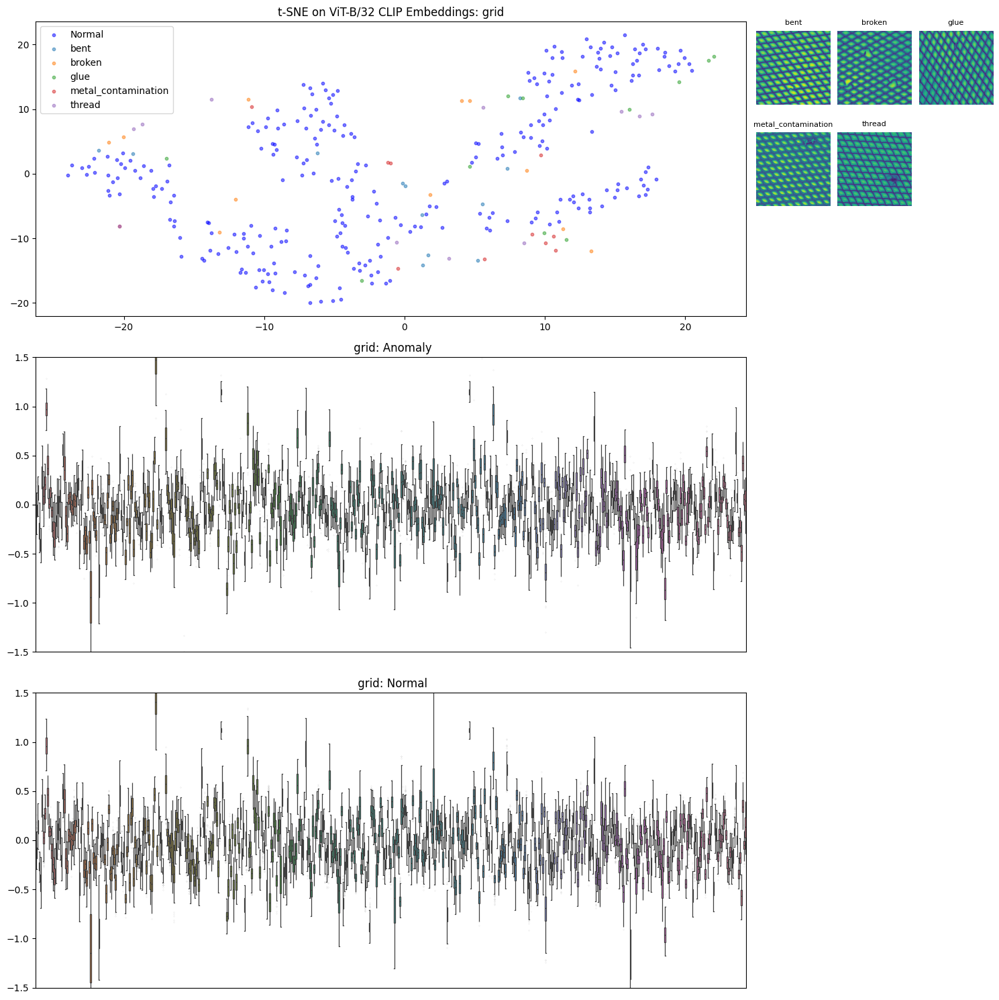

...

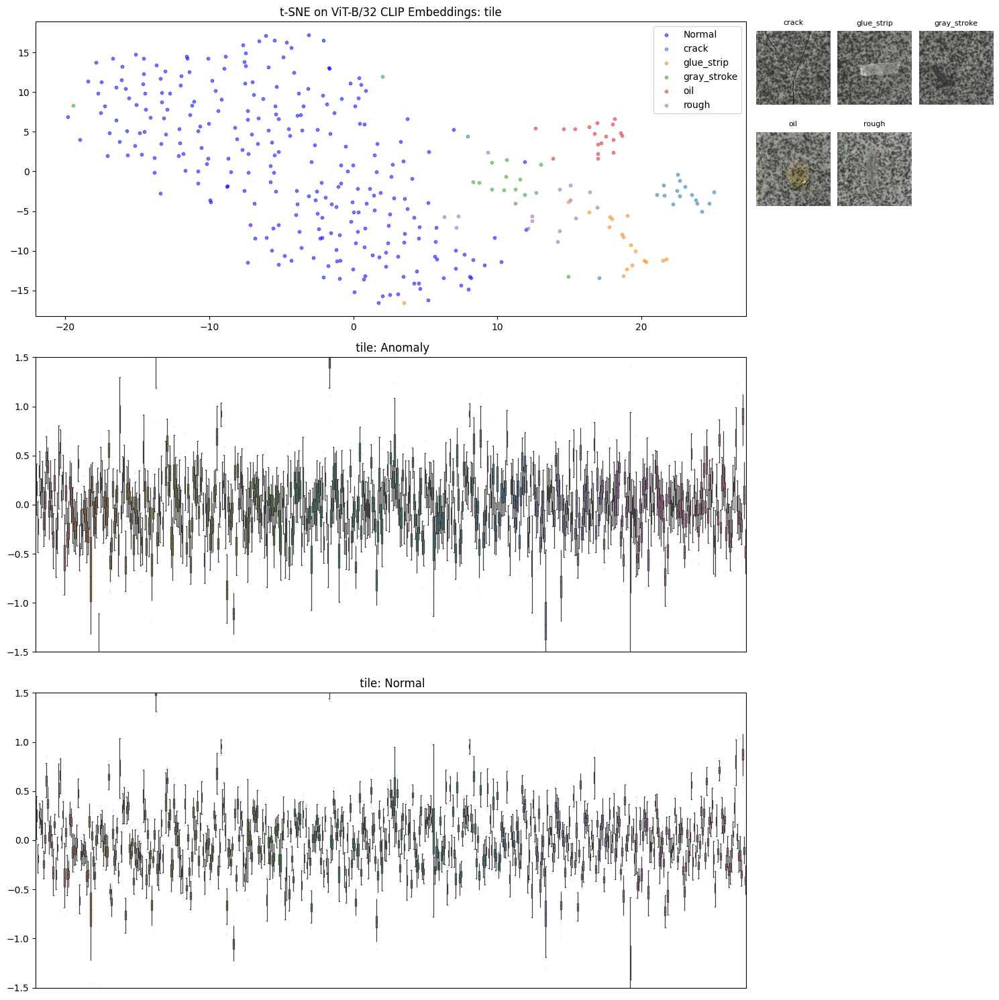

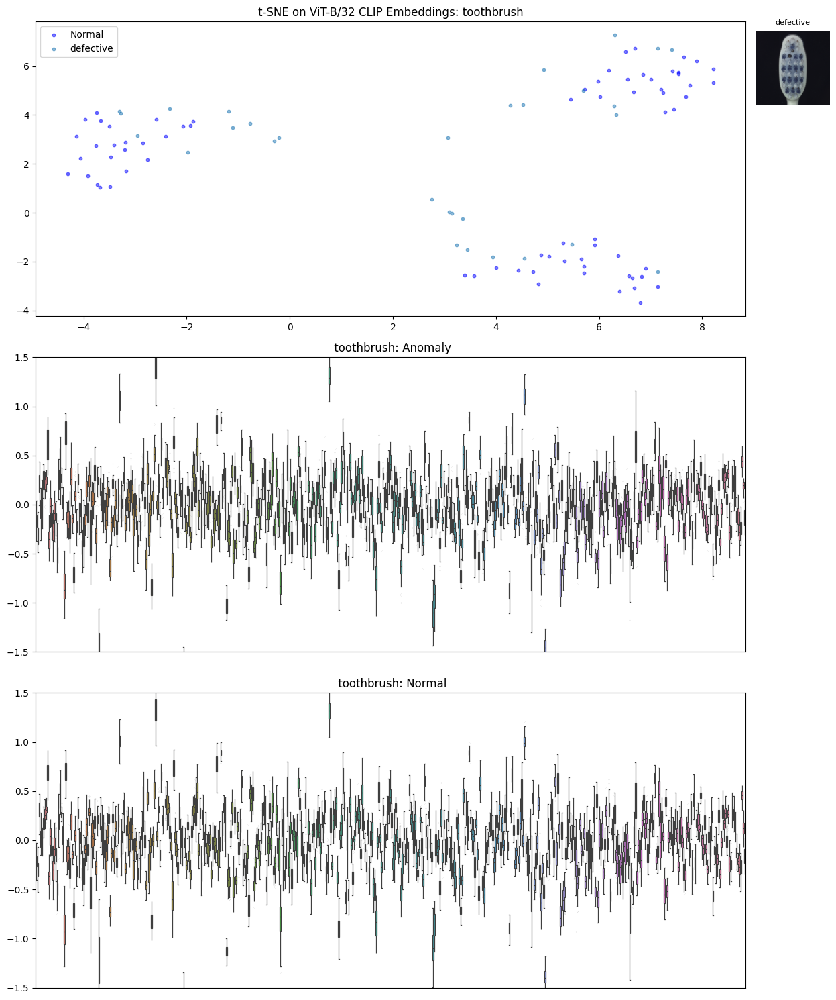

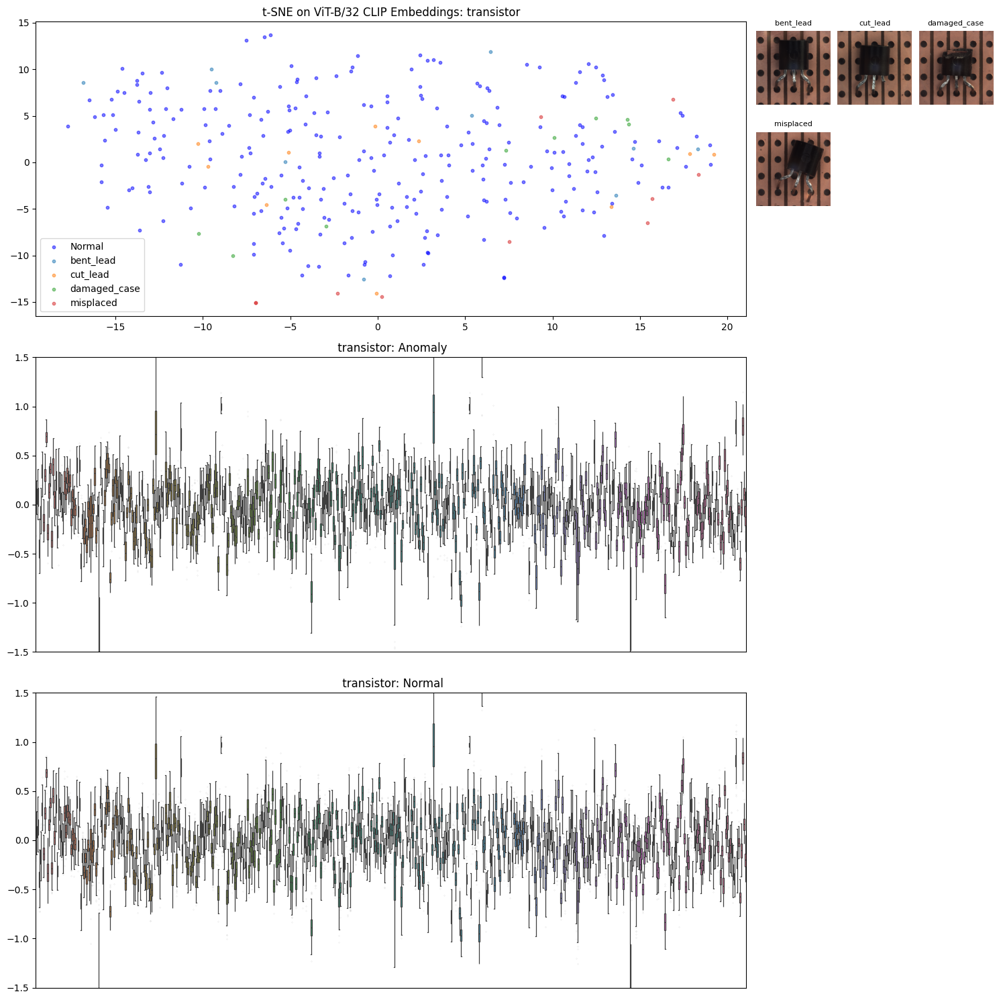

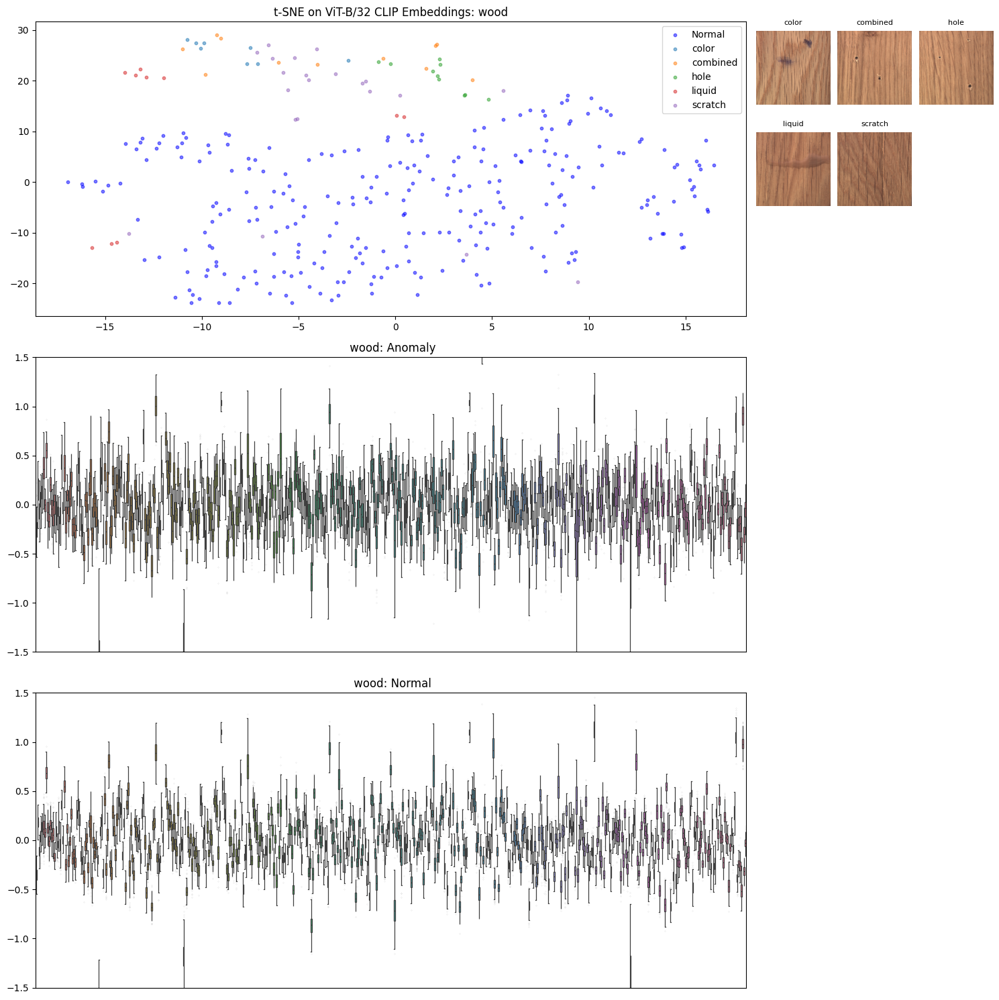

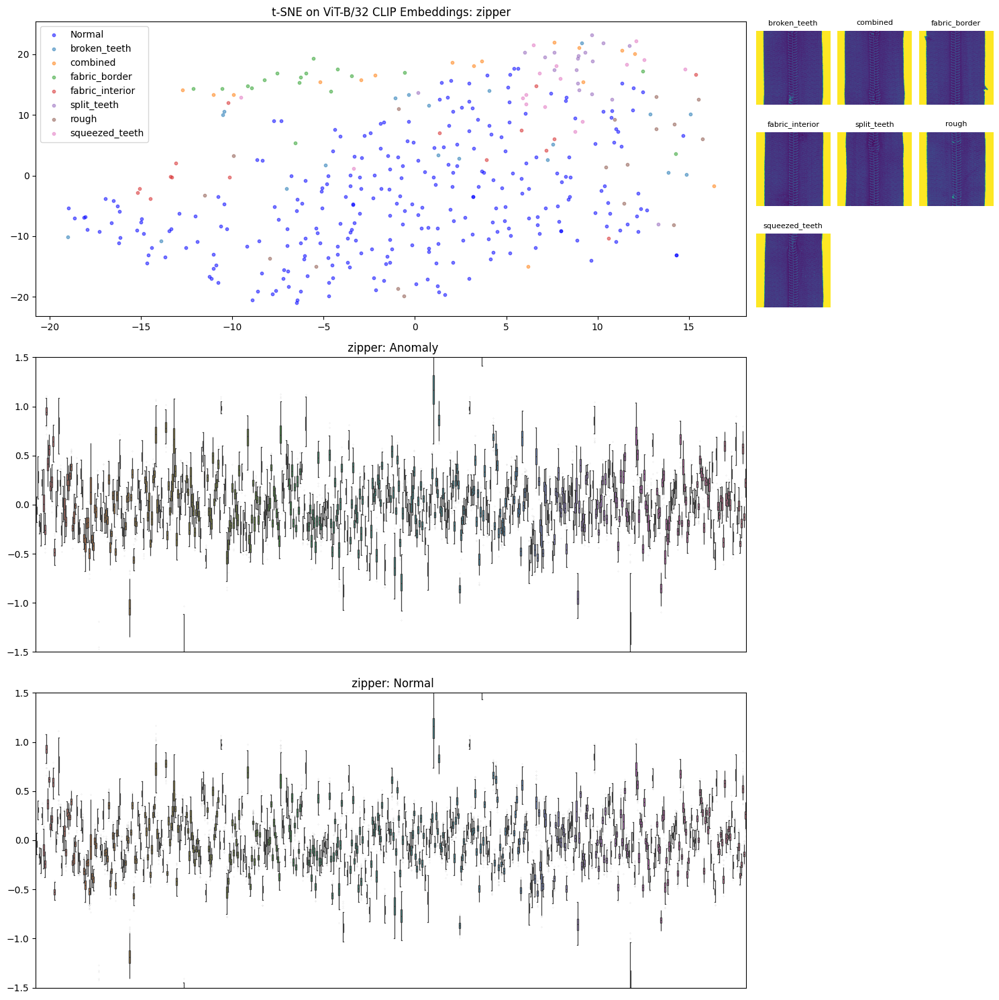

In [4]:

for category in list(anomaly_categories.keys()):
    # filter for category
    df_category = df[df.index.str.contains(category)]
    
    # Convert the resulting series of lists to a NumPy array
    numpy_array = df_category.to_numpy()
    # Apply t-SNE to reduce the dimensionality of the embeddings
    tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, n_jobs=-1, random_state=42)
    tsne_embeddings = tsne.fit_transform(numpy_array)
    
    # filter for anomaly and normal
    df_category_anomaly = df_category[~df_category.index.str.contains('good')]
    df_category_normal = df_category[df_category.index.str.contains('good')]
    
    # Create figure and GridSpec layout
    fig = plt.figure(figsize=(15, 15))  # Increase figure size to accommodate images
    gs = GridSpec(3, 2, figure=fig, height_ratios=[1, 1, 1], width_ratios=[3, 1])
    
    # t-SNE plot
    ax_tsne = fig.add_subplot(gs[0, 0])
    # Anomaly boxplot
    ax_anomaly = fig.add_subplot(gs[1, 0])  # Span full row
    # Normal boxplot
    ax_normal = fig.add_subplot(gs[2, 0])  # Span full row
    
    # Inner grid for sample images
    inner_gs = GridSpecFromSubplotSpec(3, 3, subplot_spec=gs[0, 1], wspace=0.1, hspace=0.1)

    # Define the color palette for the number of anomaly types + 1 for 'Normal'
    palette = sns.color_palette('tab10', len(anomaly_categories[category]) + 1)

    # idx contains the indexes of the normal samples
    idx = df_category.index.str.contains('good')
    
    anomaly_subclasses_idx = [df_category.index.str.contains(sub) for sub in anomaly_categories[category]]

    anomaly_subclasses_paths = {sub:df_category[df_category.index.str.contains(sub)].index[0] for sub in anomaly_categories[category]}

    # Plot the normal samples in blue
    ax_tsne.scatter(tsne_embeddings[idx, 0], tsne_embeddings[idx, 1], s=10, alpha=0.5, color='blue', label='Normal')

    # Plot each type of anomaly with a different color from the palette
    for i, sub_idx in enumerate(anomaly_subclasses_idx):
        ax_tsne.scatter(tsne_embeddings[sub_idx, 0], tsne_embeddings[sub_idx, 1], s=10, alpha=0.5, color=palette[i], label=anomaly_categories[category][i])

    ax_tsne.set_title(f't-SNE on ViT-B/32 CLIP Embeddings: {category}')
    ax_tsne.legend()

    # Boxplot for the anomaly category
    sns.boxplot(data=df_category_anomaly, ax=ax_anomaly, linewidth=0.9, fliersize=0.05)
    ax_anomaly.set_ylim(-1.5, 1.5)
    ax_anomaly.set_title(f" {category}: Anomaly")
    ax_anomaly.set_xticks([])  # Hide x-axis ticks

    # Boxplot for the normal category
    sns.boxplot(data=df_category_normal, ax=ax_normal, linewidth=0.9, fliersize=0.05)
    ax_normal.set_ylim(-1.5, 1.5)
    ax_normal.set_title(f" {category}: Normal")
    ax_normal.set_xticks([])  # Hide x-axis ticks

    # Read and plot each sample image for the anomaly categories
    for i, anomaly in enumerate(anomaly_categories[category]):
        ax_image = fig.add_subplot(inner_gs[i])
        img = mpimg.imread(anomaly_subclasses_paths[anomaly])
        ax_image.imshow(img)
        ax_image.axis('off')  # Hide axes
        ax_image.set_title(anomaly, fontsize=8)

    # Adjust the layout so the plots are not overlapping
    plt.tight_layout()
    plt.show()



## PCA

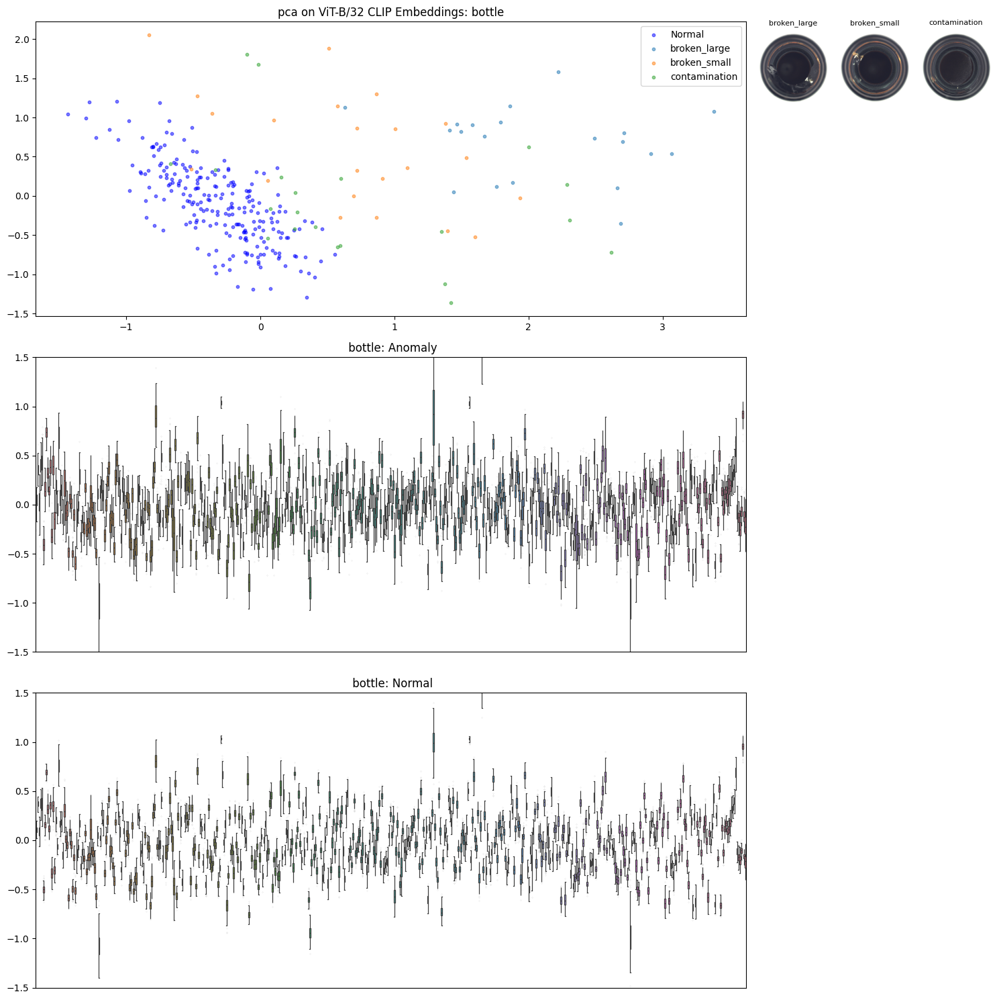

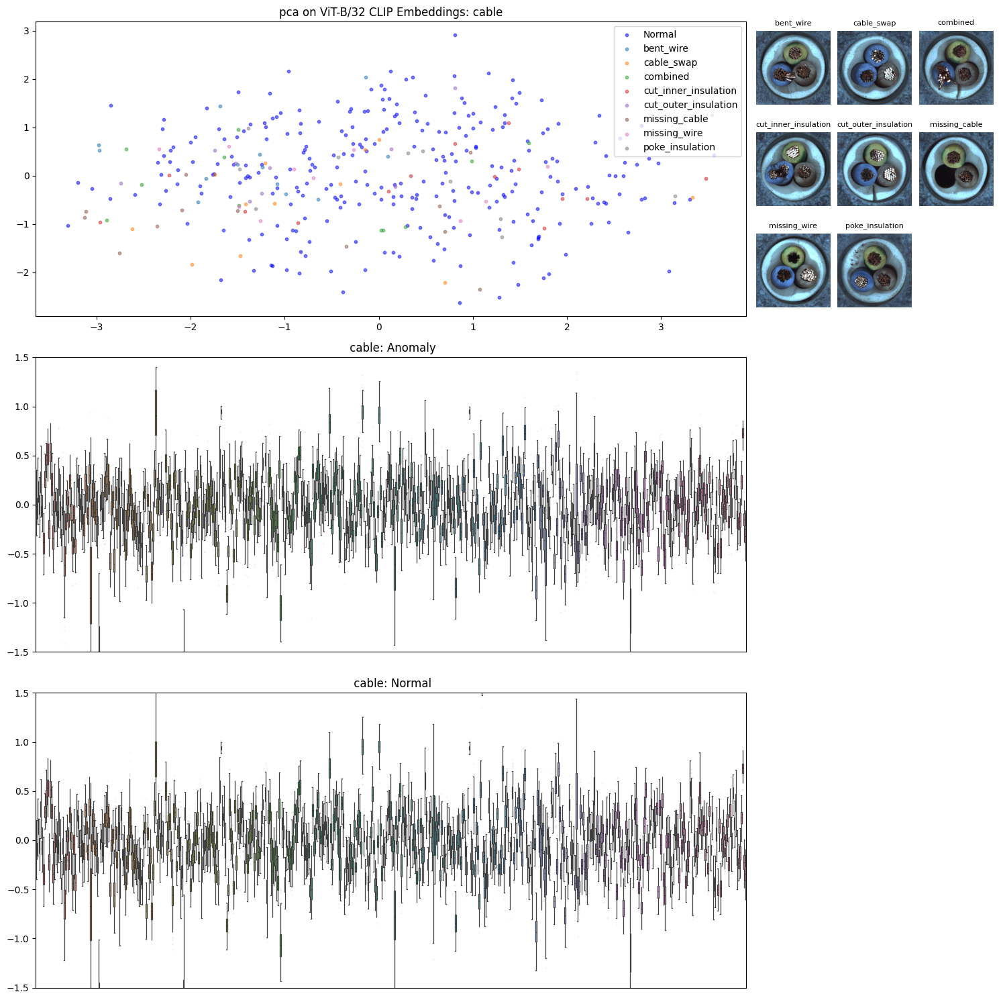

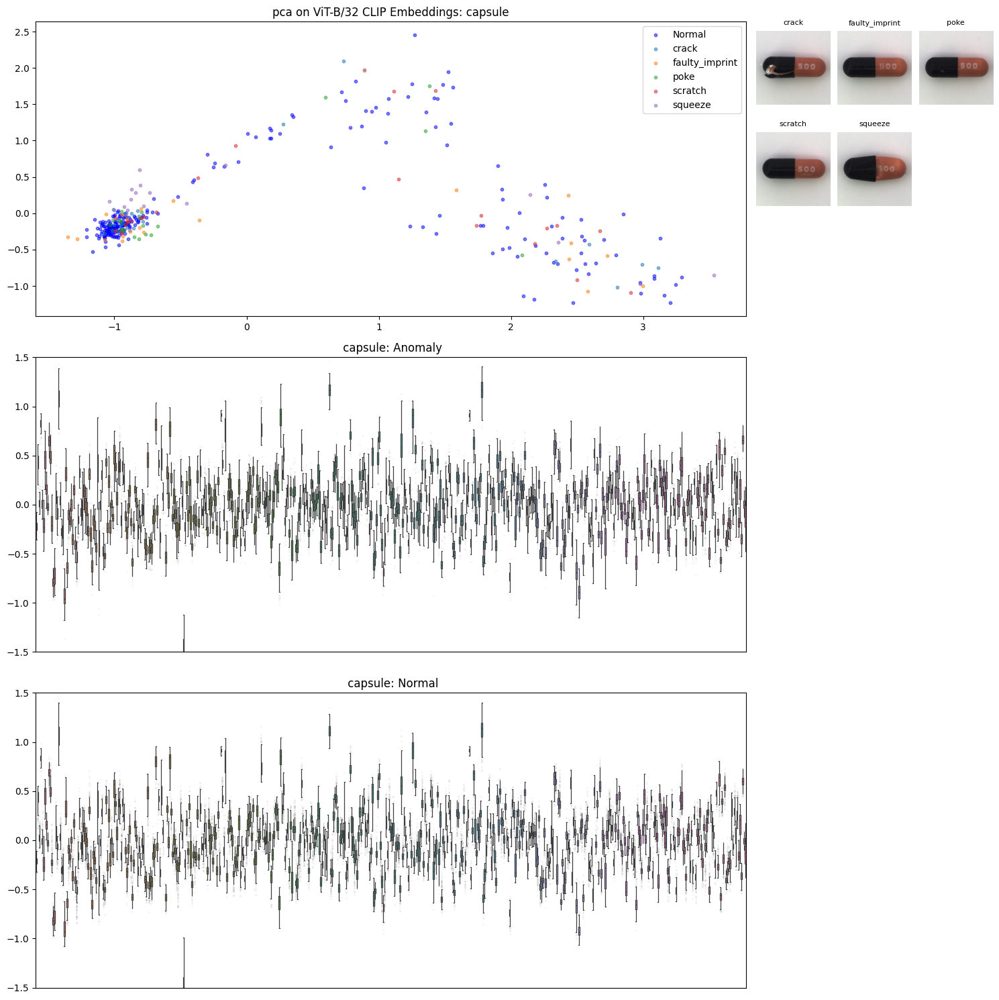

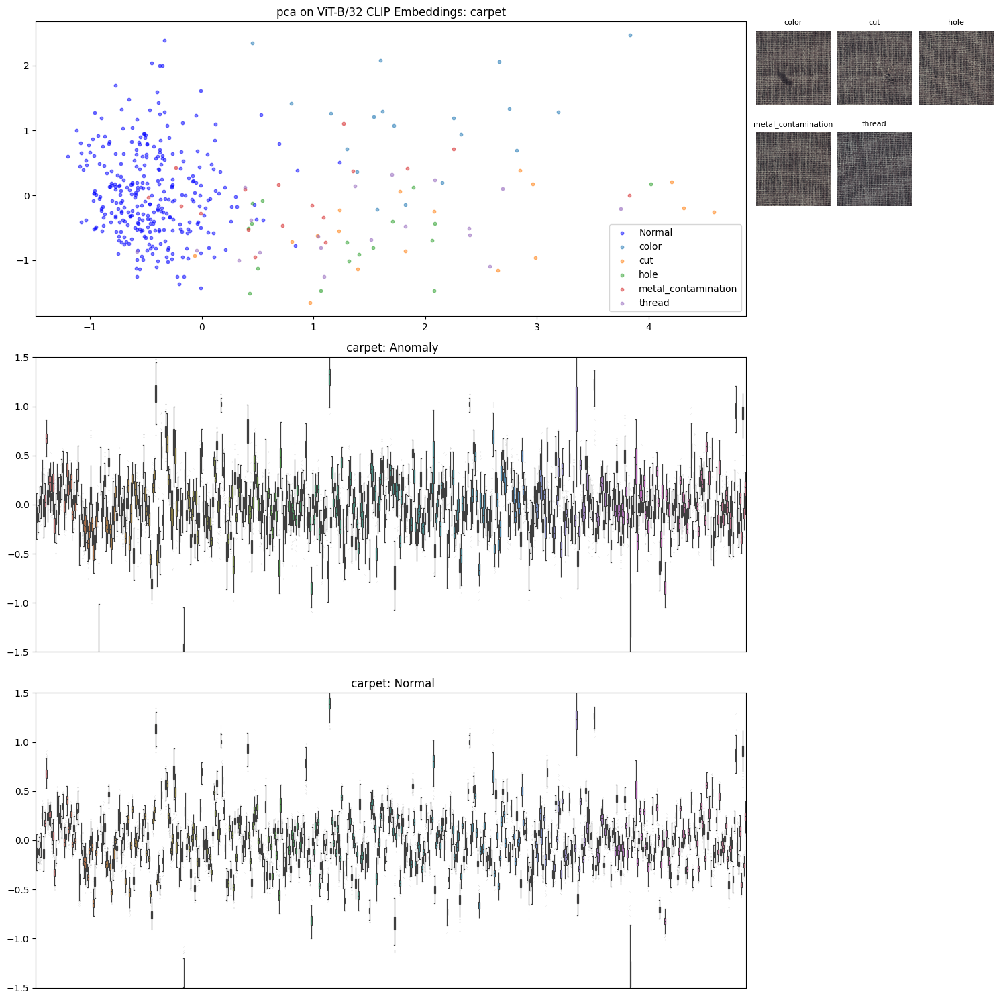

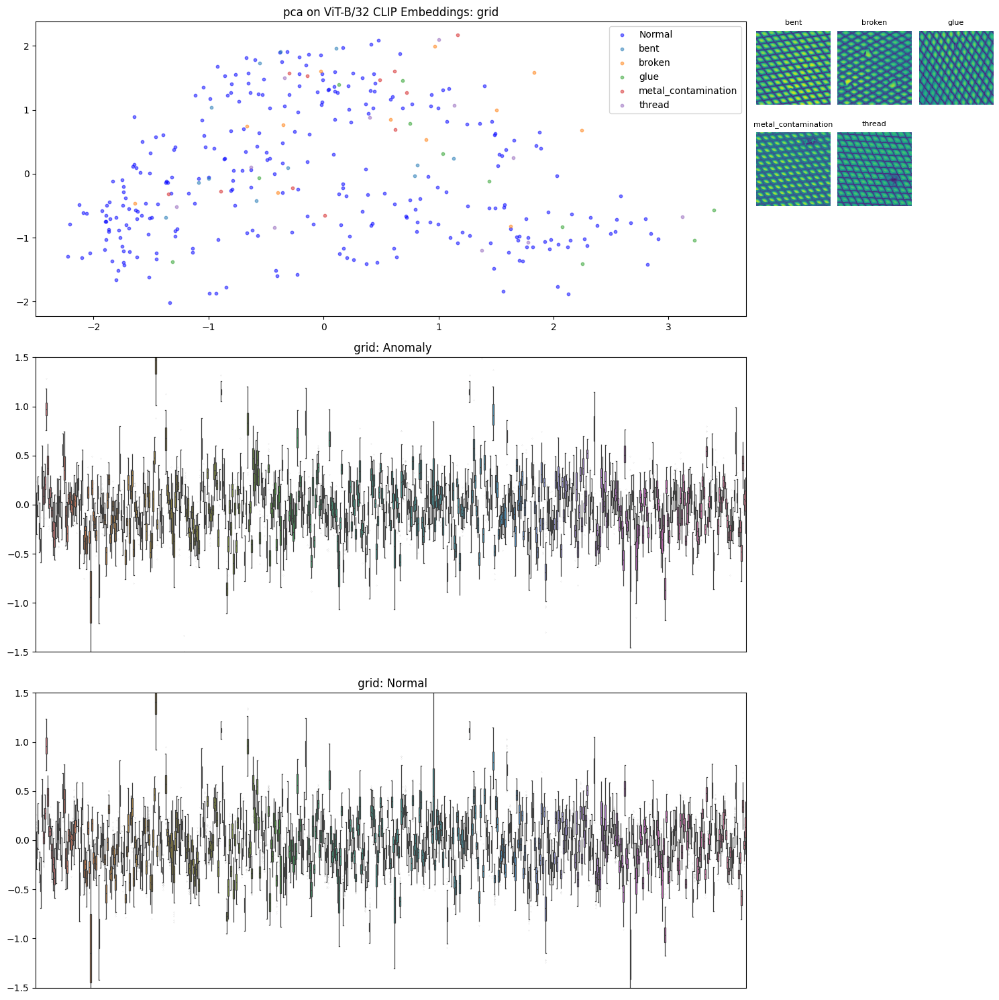

...

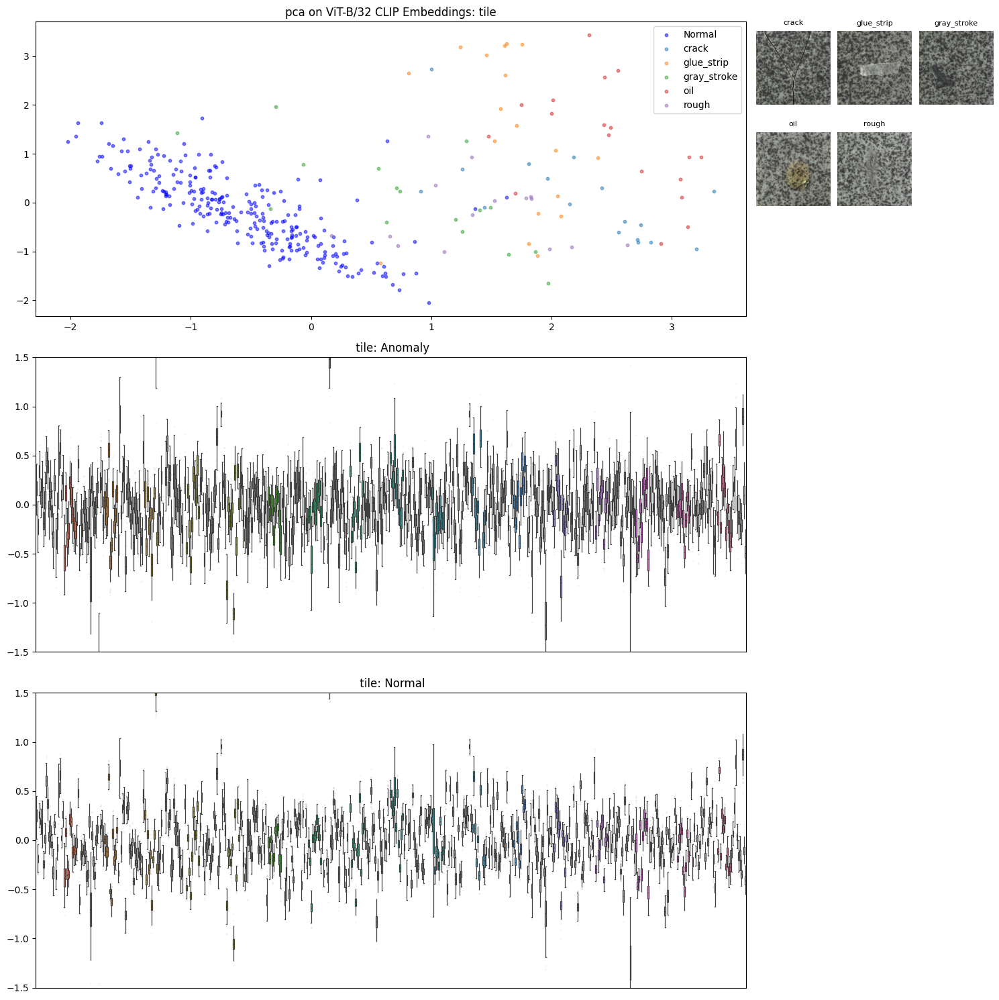

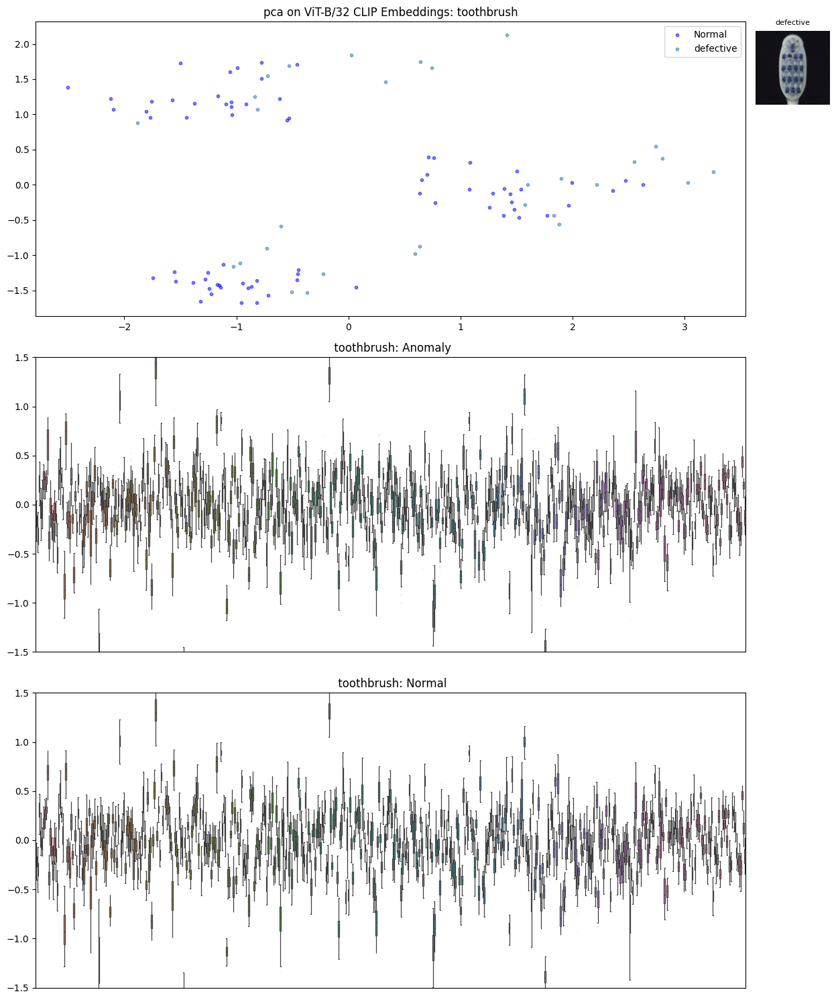

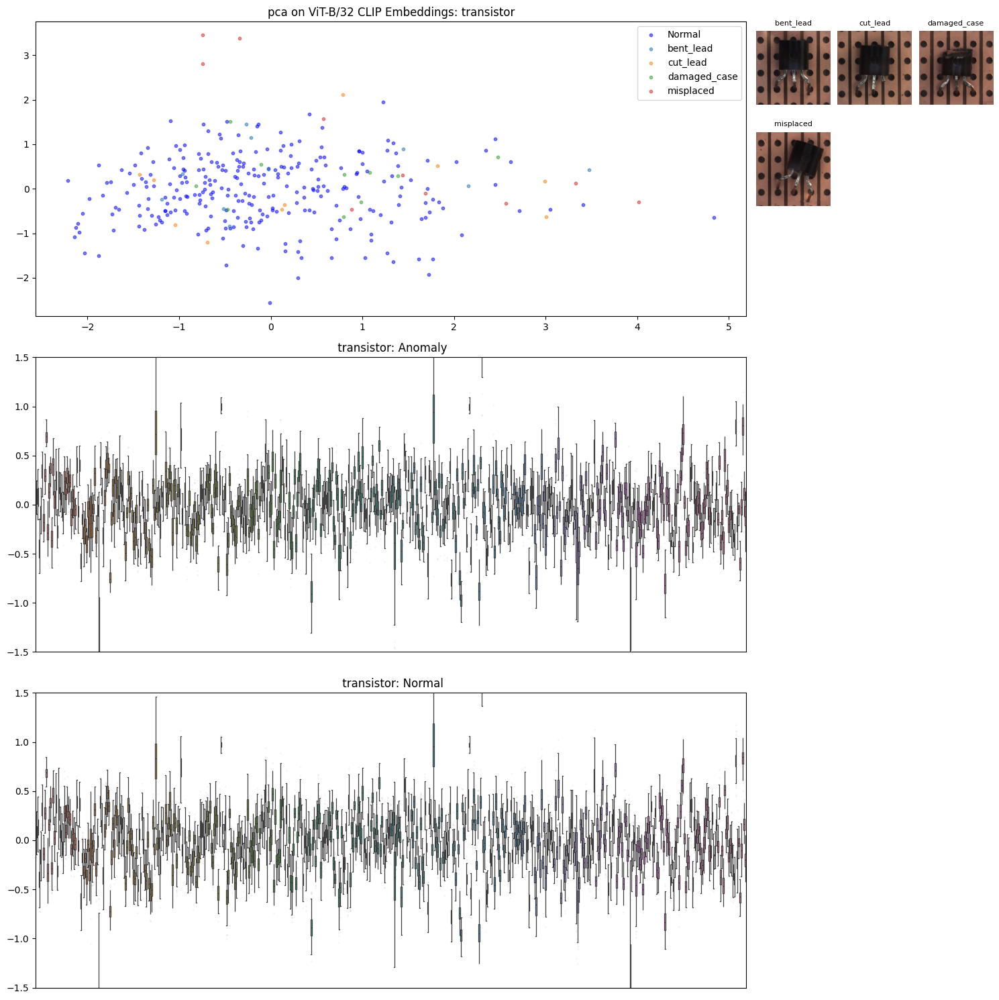

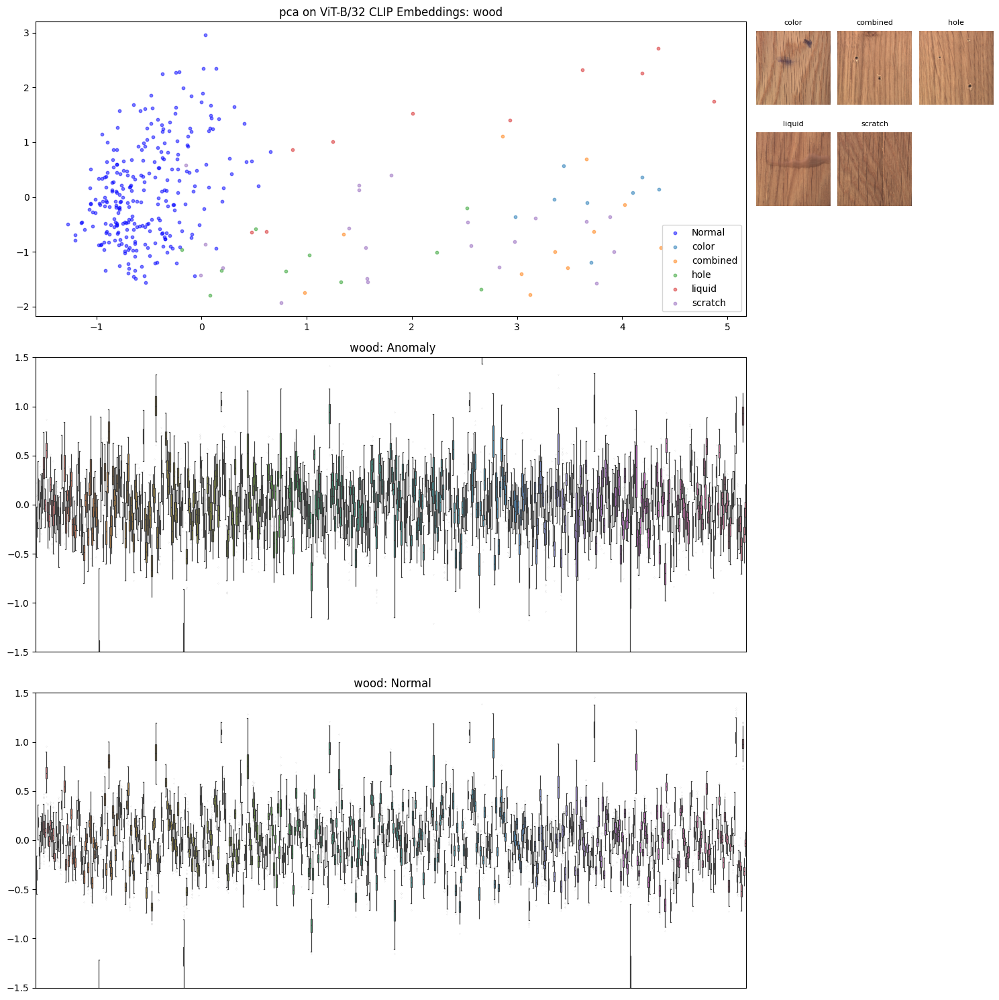

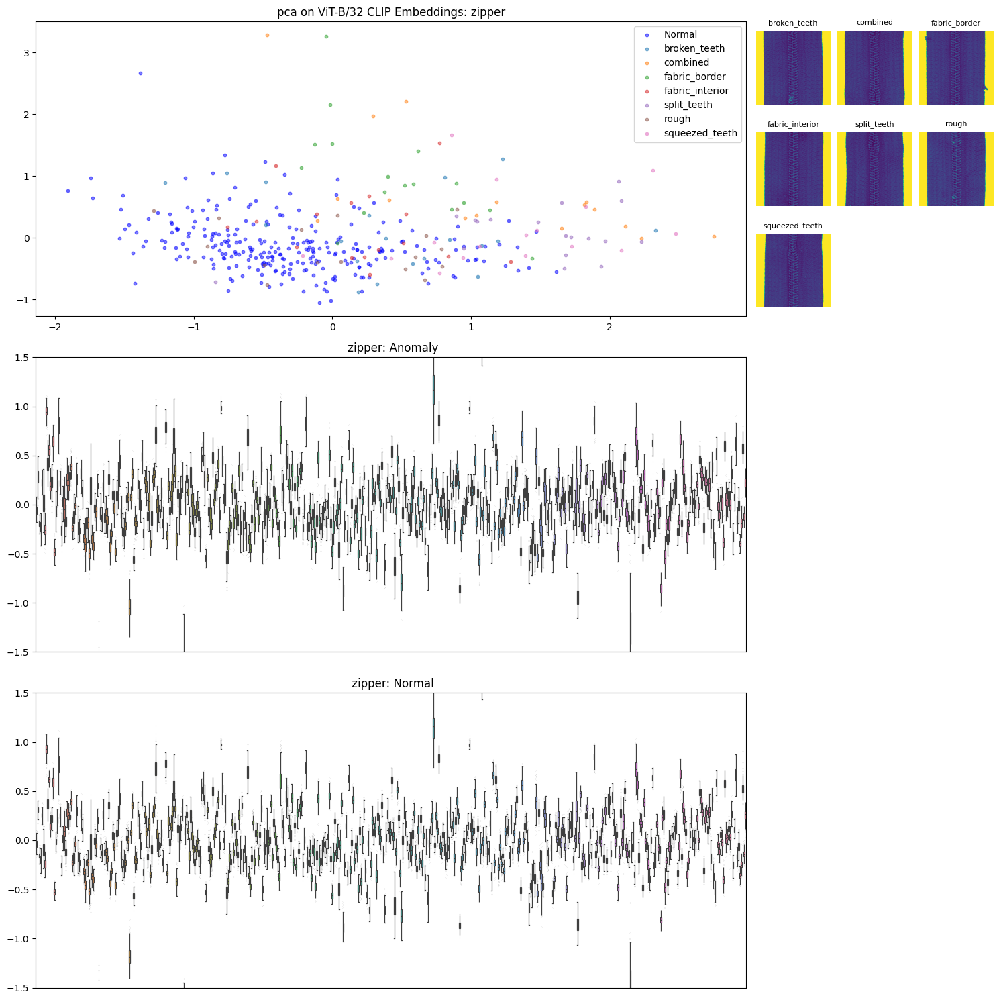

In [5]:
for category in list(anomaly_categories.keys()):
    # filter for category
    df_category = df[df.index.str.contains(category)]
    
    # Convert the resulting series of lists to a NumPy array
    numpy_array = df_category.to_numpy()
    # Apply t-SNE to reduce the dimensionality of the embeddings
    


    pca = PCA(n_components=2)
    pca_embeddings=pca.fit_transform(numpy_array)

        
    # filter for anomaly and normal
    df_category_anomaly = df_category[~df_category.index.str.contains('good')]
    df_category_normal = df_category[df_category.index.str.contains('good')]
    
    # Create figure and GridSpec layout
    fig = plt.figure(figsize=(15, 15))  # Increase figure size to accommodate images
    gs = GridSpec(3, 2, figure=fig, height_ratios=[1, 1, 1], width_ratios=[3, 1])
    
    # t-SNE plot
    ax_tsne = fig.add_subplot(gs[0, 0])
    # Anomaly boxplot
    ax_anomaly = fig.add_subplot(gs[1, 0])  # Span full row
    # Normal boxplot
    ax_normal = fig.add_subplot(gs[2, 0])  # Span full row
    
    # Inner grid for sample images
    inner_gs = GridSpecFromSubplotSpec(3, 3, subplot_spec=gs[0, 1], wspace=0.1, hspace=0.1)

    # Define the color palette for the number of anomaly types + 1 for 'Normal'
    palette = sns.color_palette('tab10', len(anomaly_categories[category]) + 1)

    # idx contains the indexes of the normal samples
    idx = df_category.index.str.contains('good')
    
    anomaly_subclasses_idx = [df_category.index.str.contains(sub) for sub in anomaly_categories[category]]

    anomaly_subclasses_paths = {sub:df_category[df_category.index.str.contains(sub)].index[0] for sub in anomaly_categories[category]}

    # Plot the normal samples in blue
    ax_tsne.scatter(pca_embeddings[idx, 0], pca_embeddings[idx, 1], s=10, alpha=0.5, color='blue', label='Normal')

    # Plot each type of anomaly with a different color from the palette
    for i, sub_idx in enumerate(anomaly_subclasses_idx):
        ax_tsne.scatter(pca_embeddings[sub_idx, 0], pca_embeddings[sub_idx, 1], s=10, alpha=0.5, color=palette[i], label=anomaly_categories[category][i])

    ax_tsne.set_title(f'pca on ViT-B/32 CLIP Embeddings: {category}')
    ax_tsne.legend()

    # Boxplot for the anomaly category
    sns.boxplot(data=df_category_anomaly, ax=ax_anomaly, linewidth=0.9, fliersize=0.05)
    ax_anomaly.set_ylim(-1.5, 1.5)
    ax_anomaly.set_title(f" {category}: Anomaly")
    ax_anomaly.set_xticks([])  # Hide x-axis ticks

    # Boxplot for the normal category
    sns.boxplot(data=df_category_normal, ax=ax_normal, linewidth=0.9, fliersize=0.05)
    ax_normal.set_ylim(-1.5, 1.5)
    ax_normal.set_title(f" {category}: Normal")
    ax_normal.set_xticks([])  # Hide x-axis ticks

    # Read and plot each sample image for the anomaly categories
    for i, anomaly in enumerate(anomaly_categories[category]):
        ax_image = fig.add_subplot(inner_gs[i])
        img = mpimg.imread(anomaly_subclasses_paths[anomaly])
        ax_image.imshow(img)
        ax_image.axis('off')  # Hide axes
        ax_image.set_title(anomaly, fontsize=8)

    # Adjust the layout so the plots are not overlapping
    plt.tight_layout()
    plt.show()



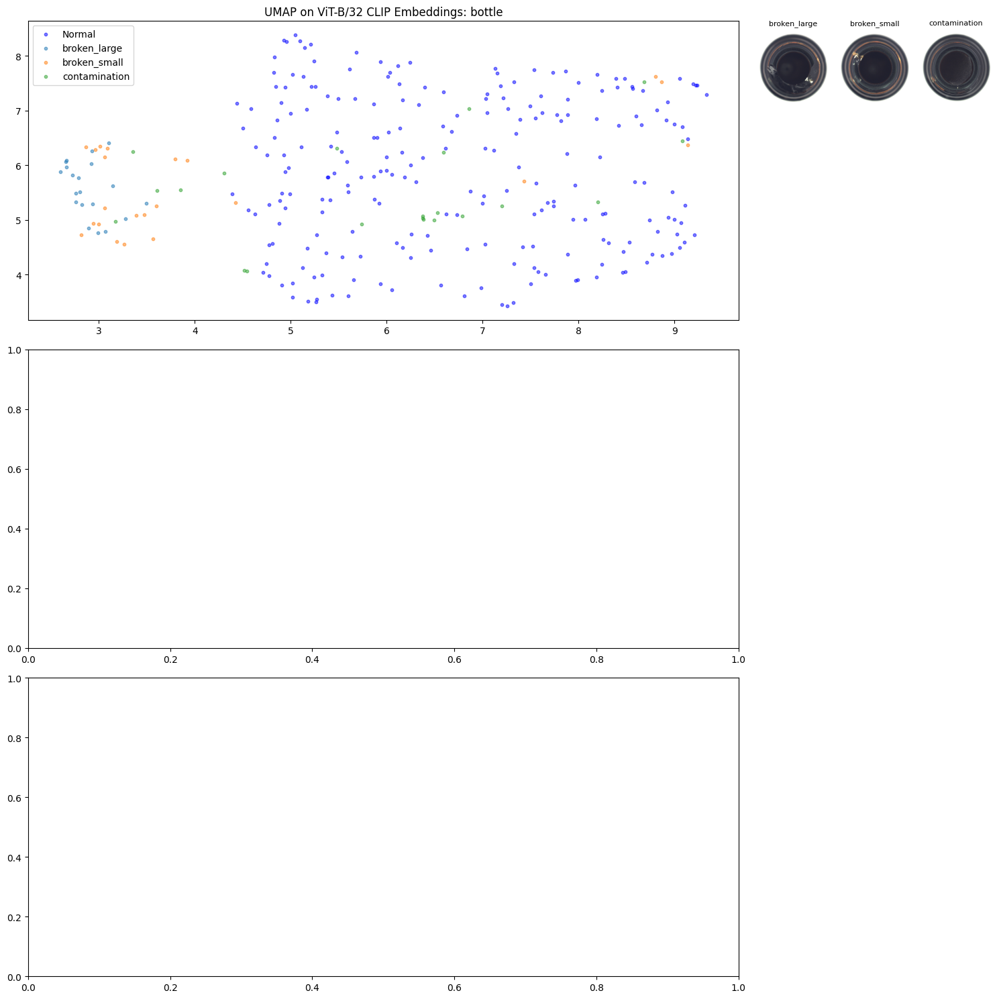

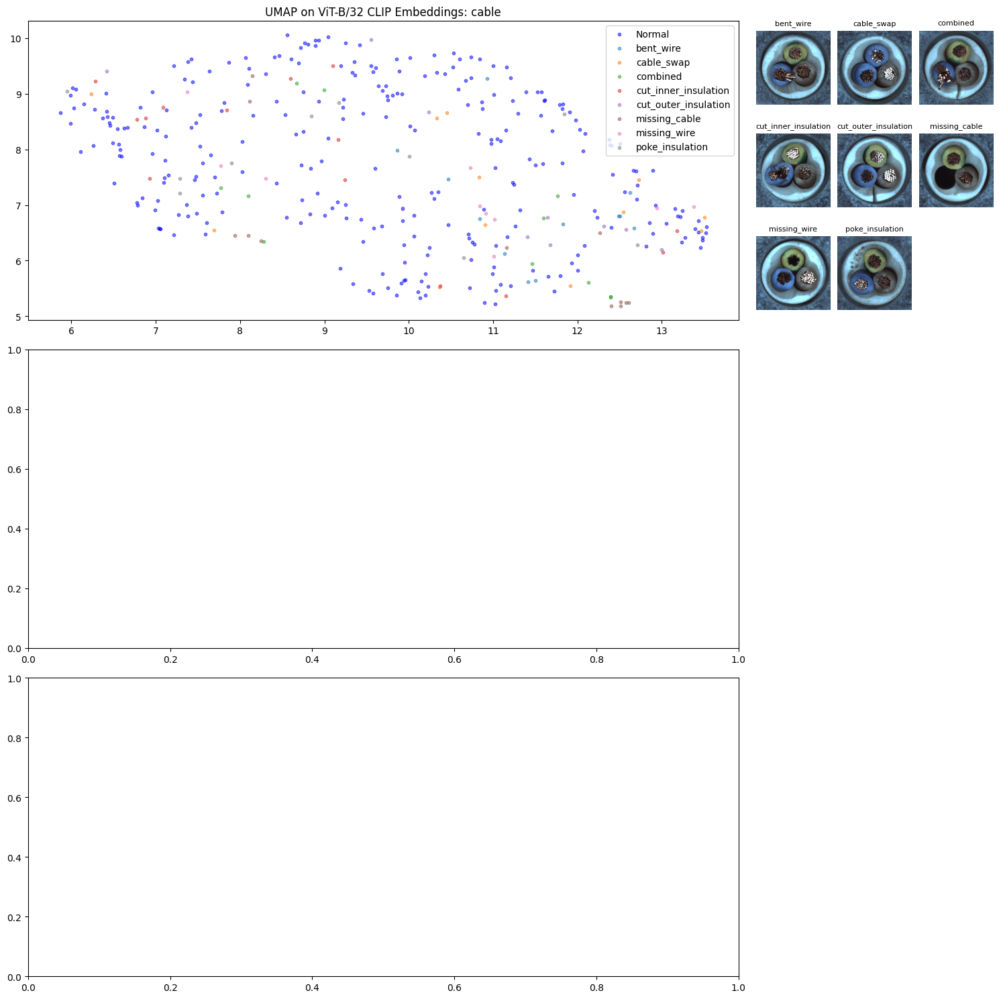

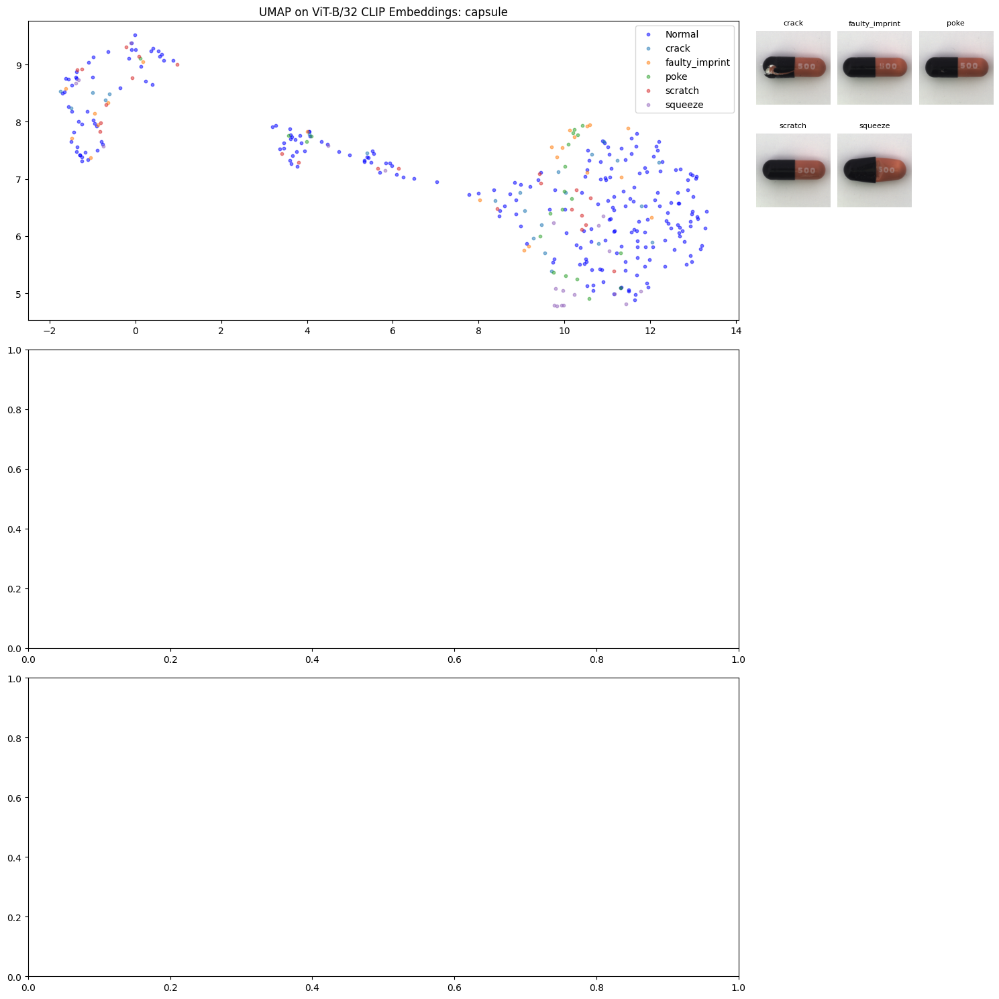

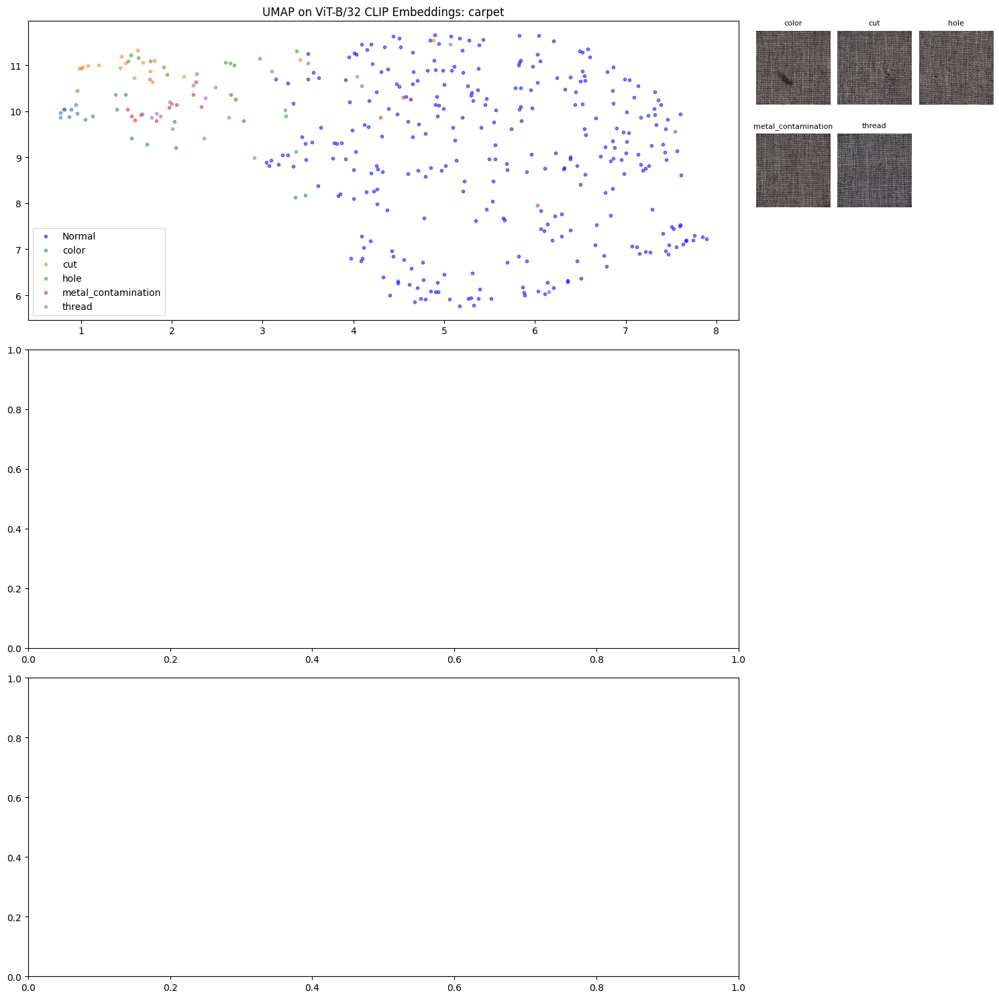

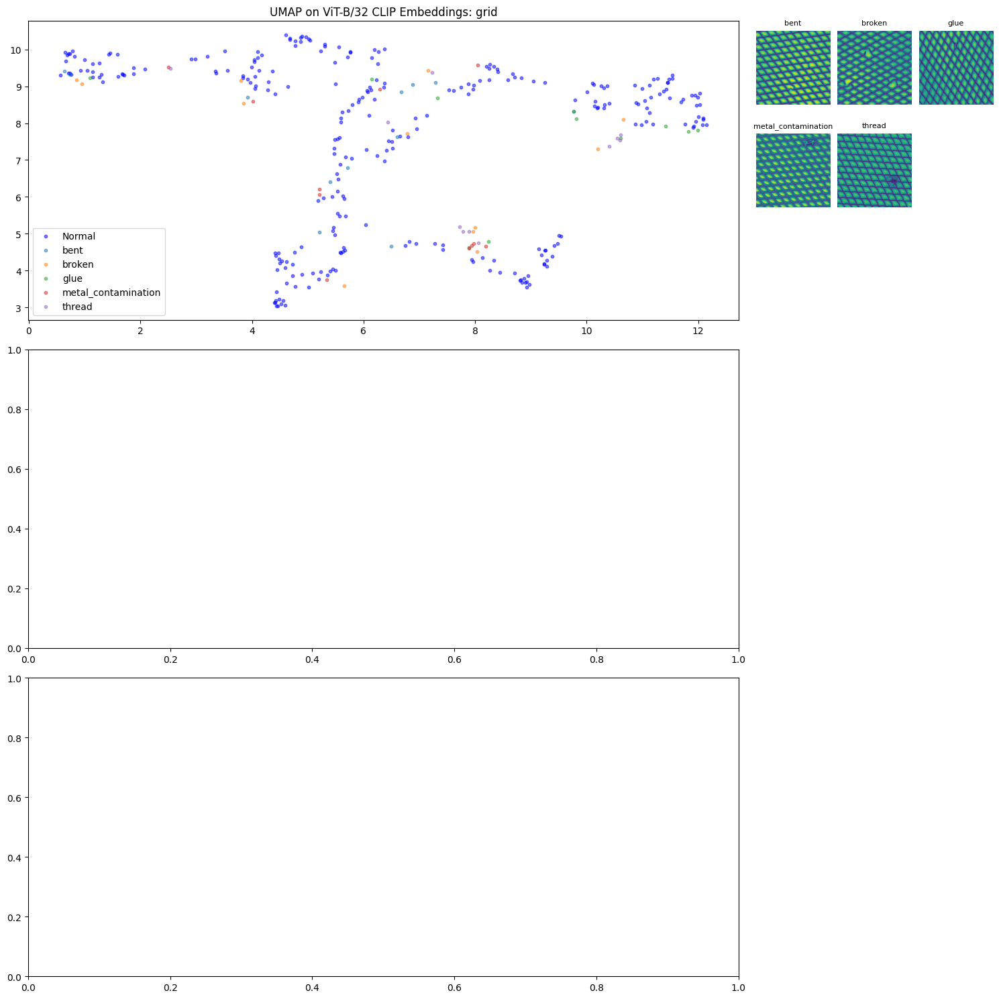

...

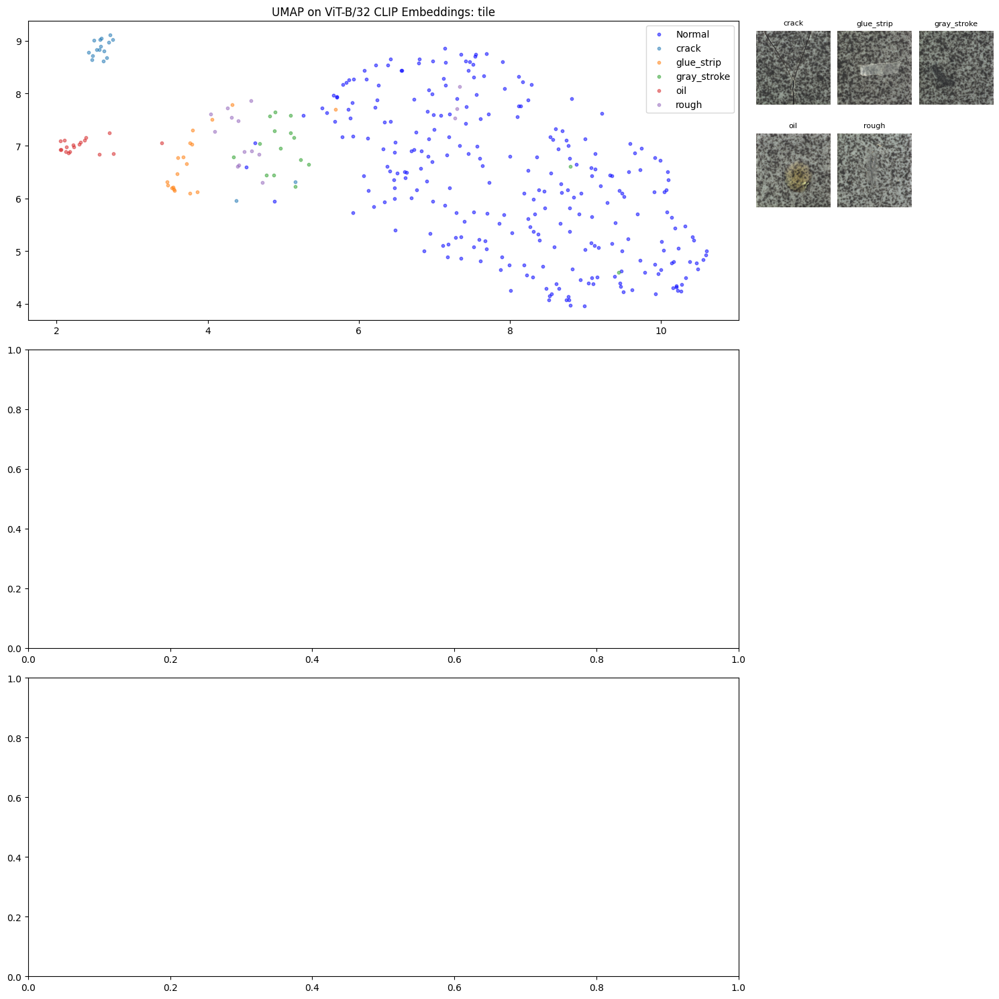

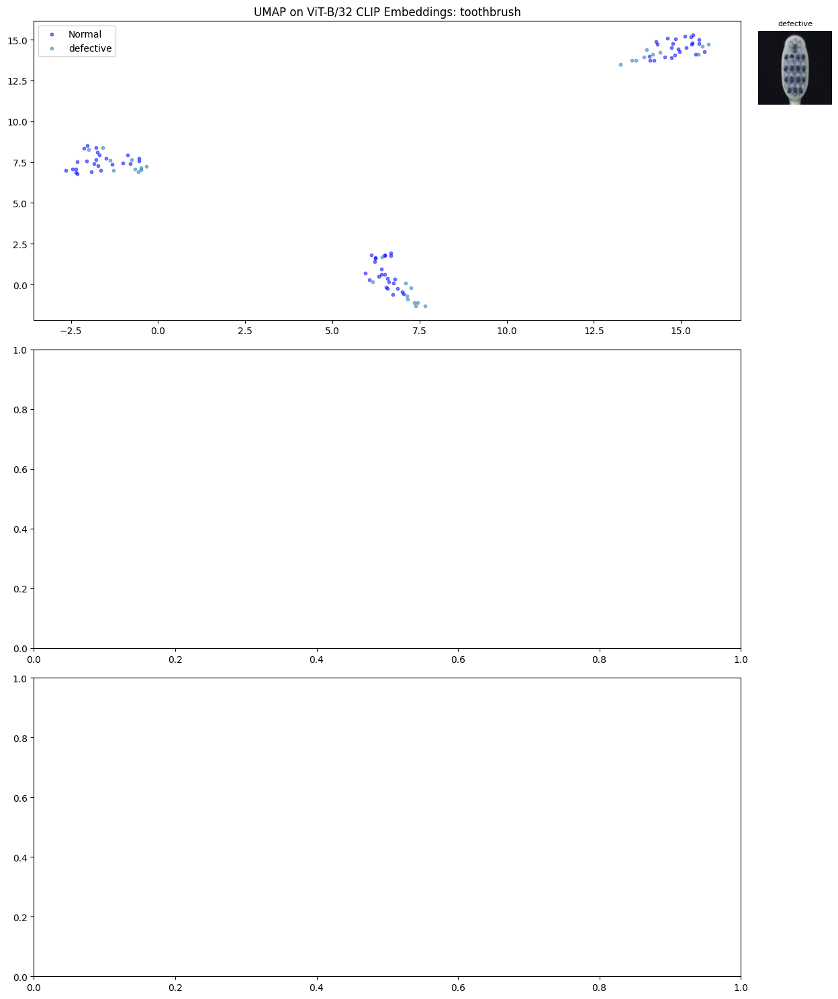

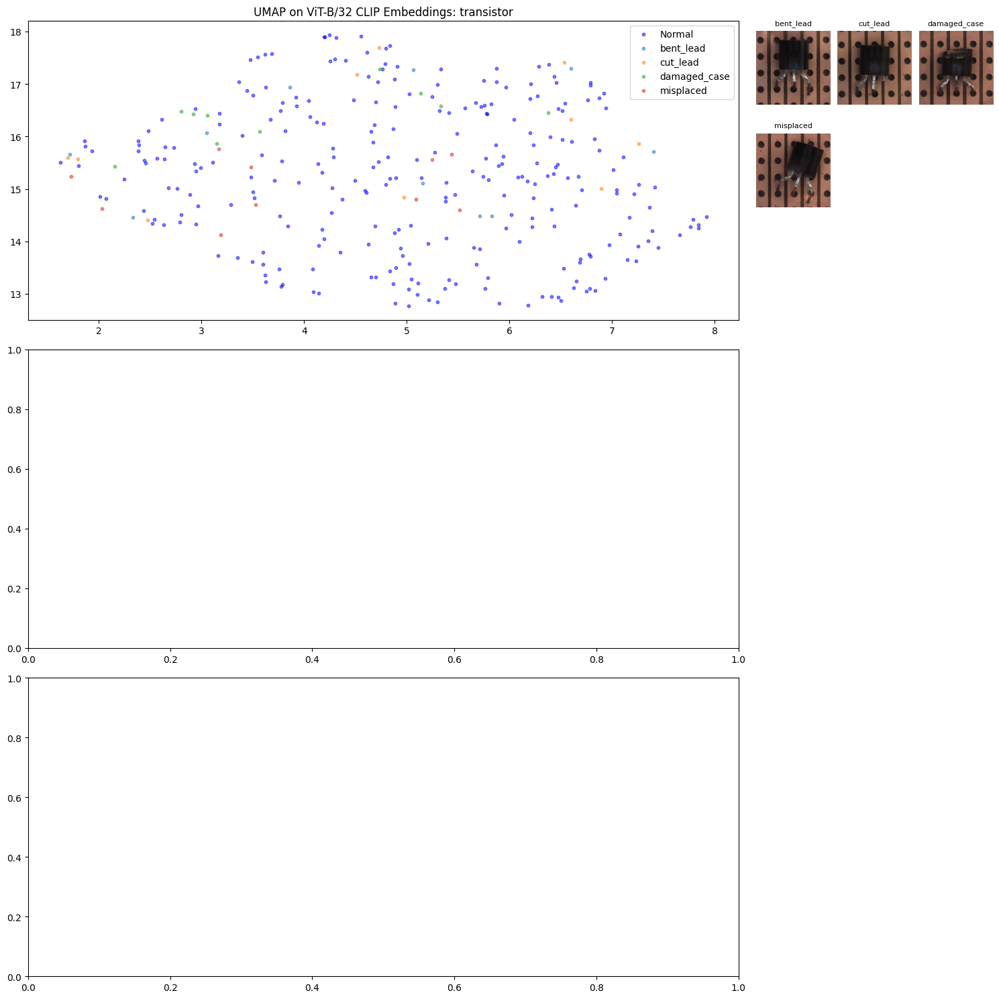

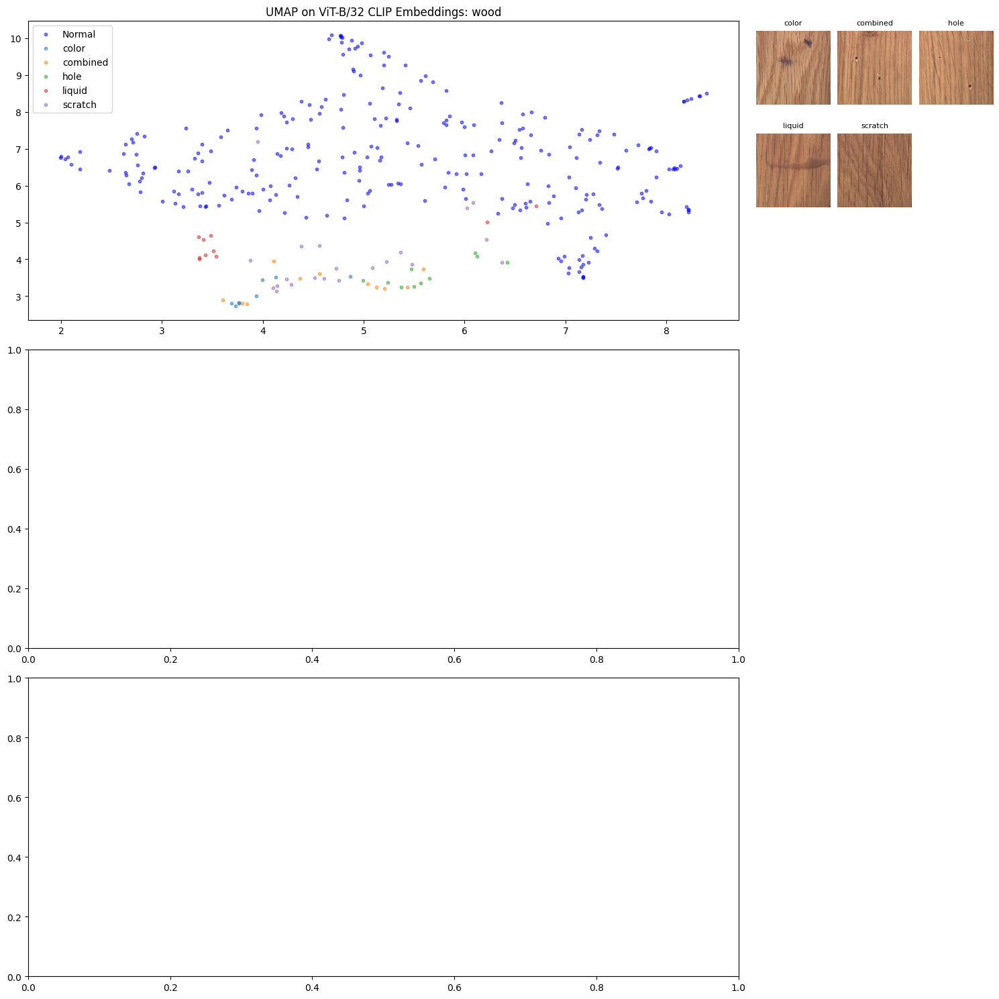

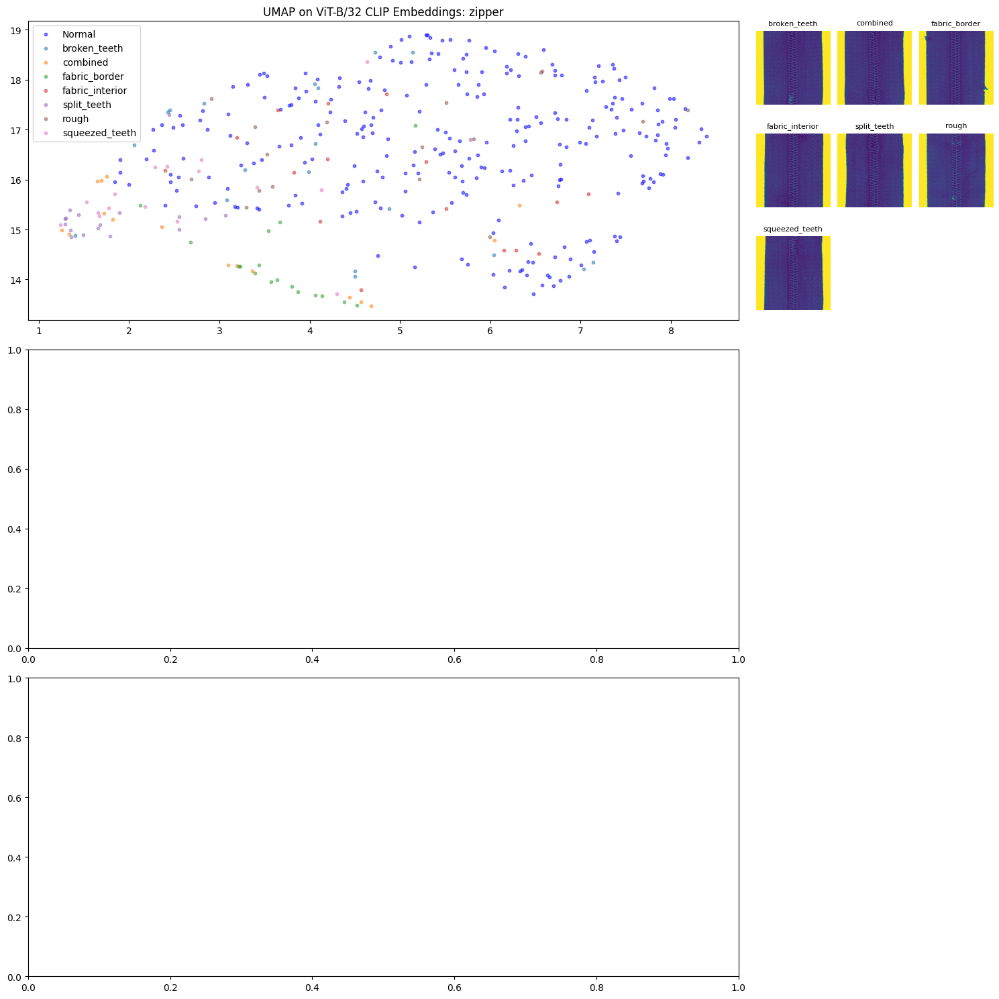

In [6]:


# Assuming df, anomaly_categories are already defined

for category in list(anomaly_categories.keys()):
    # Filter for category
    df_category = df[df.index.str.contains(category)]
    
    # Convert the resulting series of lists to a NumPy array
    numpy_array = df_category.to_numpy()

    # Apply UMAP to reduce the dimensionality of the embeddings
    reducer = umap.UMAP(n_components=2)
    umap_embeddings = reducer.fit_transform(numpy_array)
    
    # Filter for anomaly and normal
    df_category_anomaly = df_category[~df_category.index.str.contains('good')]
    df_category_normal = df_category[df_category.index.str.contains('good')]
    
    # Create figure and GridSpec layout
    fig = plt.figure(figsize=(15, 15))  # Increase figure size to accommodate images
    gs = GridSpec(3, 2, figure=fig, height_ratios=[1, 1, 1], width_ratios=[3, 1])
    
    # UMAP plot
    ax_umap = fig.add_subplot(gs[0, 0])
    
    # Anomaly and Normal boxplot axes
    ax_anomaly = fig.add_subplot(gs[1, 0])
    ax_normal = fig.add_subplot(gs[2, 0])
    
    # Inner grid for sample images
    inner_gs = GridSpecFromSubplotSpec(3, 3, subplot_spec=gs[0, 1], wspace=0.1, hspace=0.1)

    # Define the color palette
    palette = sns.color_palette('tab10', len(anomaly_categories[category]) + 1)

    # Index of normal samples
    idx = df_category.index.str.contains('good')
    anomaly_subclasses_idx = [df_category.index.str.contains(sub) for sub in anomaly_categories[category]]
    anomaly_subclasses_paths = {sub:df_category[df_category.index.str.contains(sub)].index[0] for sub in anomaly_categories[category]}

    # Plot normal samples
    ax_umap.scatter(umap_embeddings[idx, 0], umap_embeddings[idx, 1], s=10, alpha=0.5, color='blue', label='Normal')

    # Plot each type of anomaly
    for i, sub_idx in enumerate(anomaly_subclasses_idx):
        ax_umap.scatter(umap_embeddings[sub_idx, 0], umap_embeddings[sub_idx, 1], s=10, alpha=0.5, color=palette[i], label=anomaly_categories[category][i])

    ax_umap.set_title(f'UMAP on ViT-B/32 CLIP Embeddings: {category}')
    ax_umap.legend()

    # Uncomment below for boxplots
    # sns.boxplot(data=df_category_anomaly, ax=ax_anomaly, linewidth=0.9, fliersize=0.05)
    # ax_anomaly.set_ylim(-1.5, 1.5)
    # ax_anomaly.set_title(f" {category}: Anomaly")
    # ax_anomaly.set_xticks([])

    # sns.boxplot(data=df_category_normal, ax=ax_normal, linewidth=0.9, fliersize=0.05)
    # ax_normal.set_ylim(-1.5, 1.5)
    # ax_normal.set_title(f" {category}: Normal")
    # ax_normal.set_xticks([])

    # Plot each sample image for anomaly categories
    for i, anomaly in enumerate(anomaly_categories[category]):
        ax_image = fig.add_subplot(inner_gs[i])
        img = mpimg.imread(anomaly_subclasses_paths[anomaly])
        ax_image.imshow(img)
        ax_image.axis('off')
        ax_image.set_title(anomaly, fontsize=8)

    plt.tight_layout()
    plt.show()


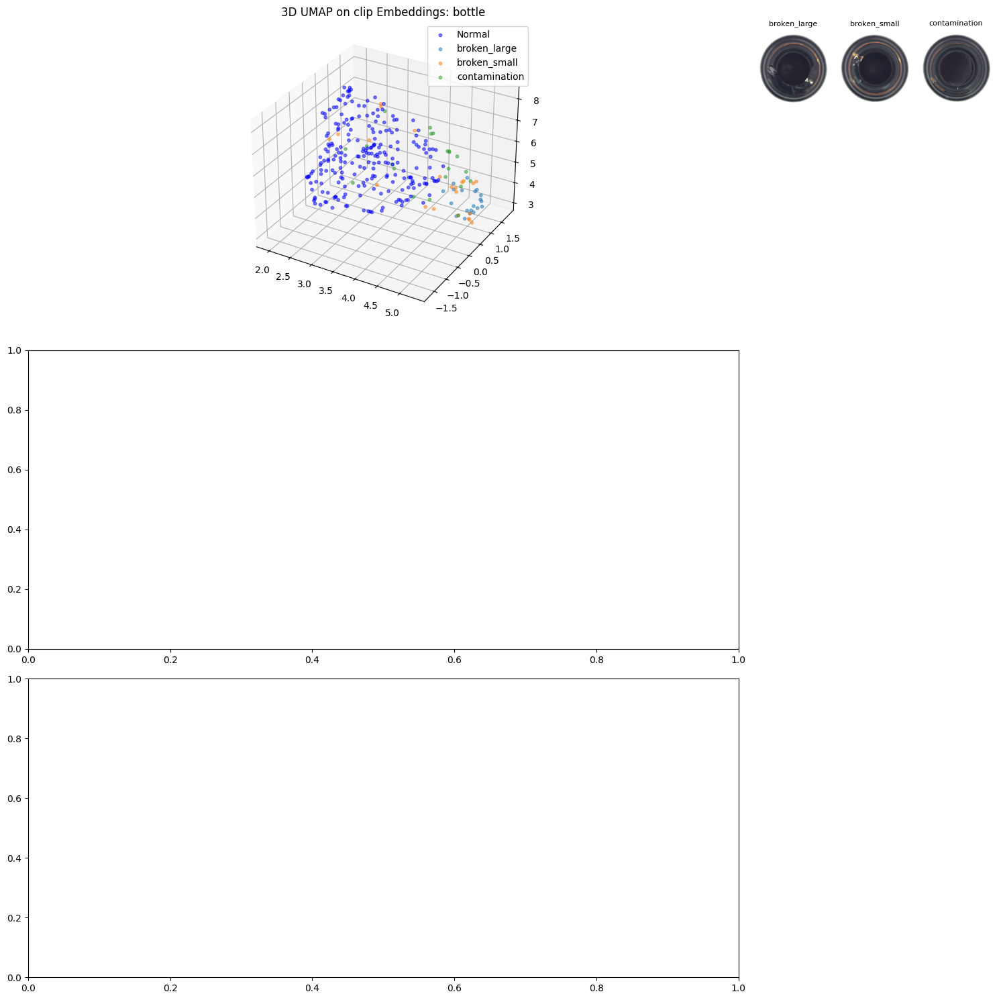

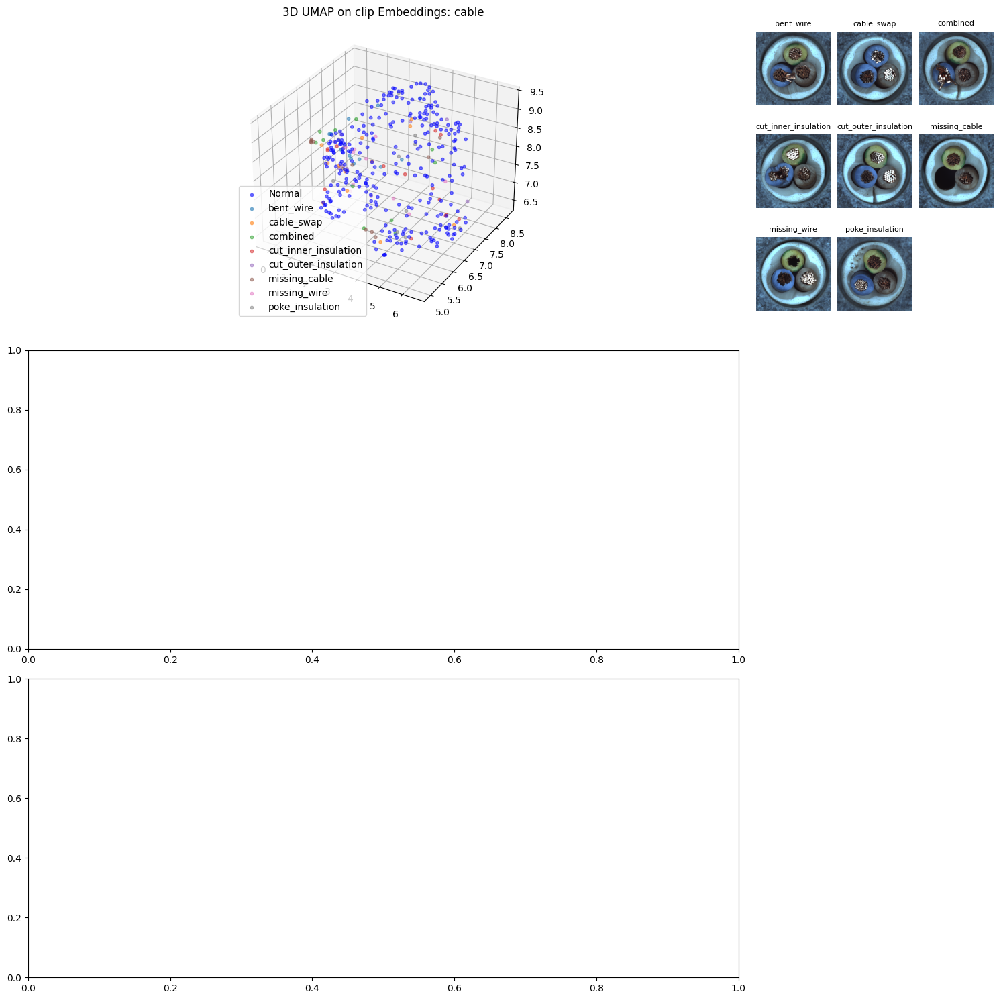

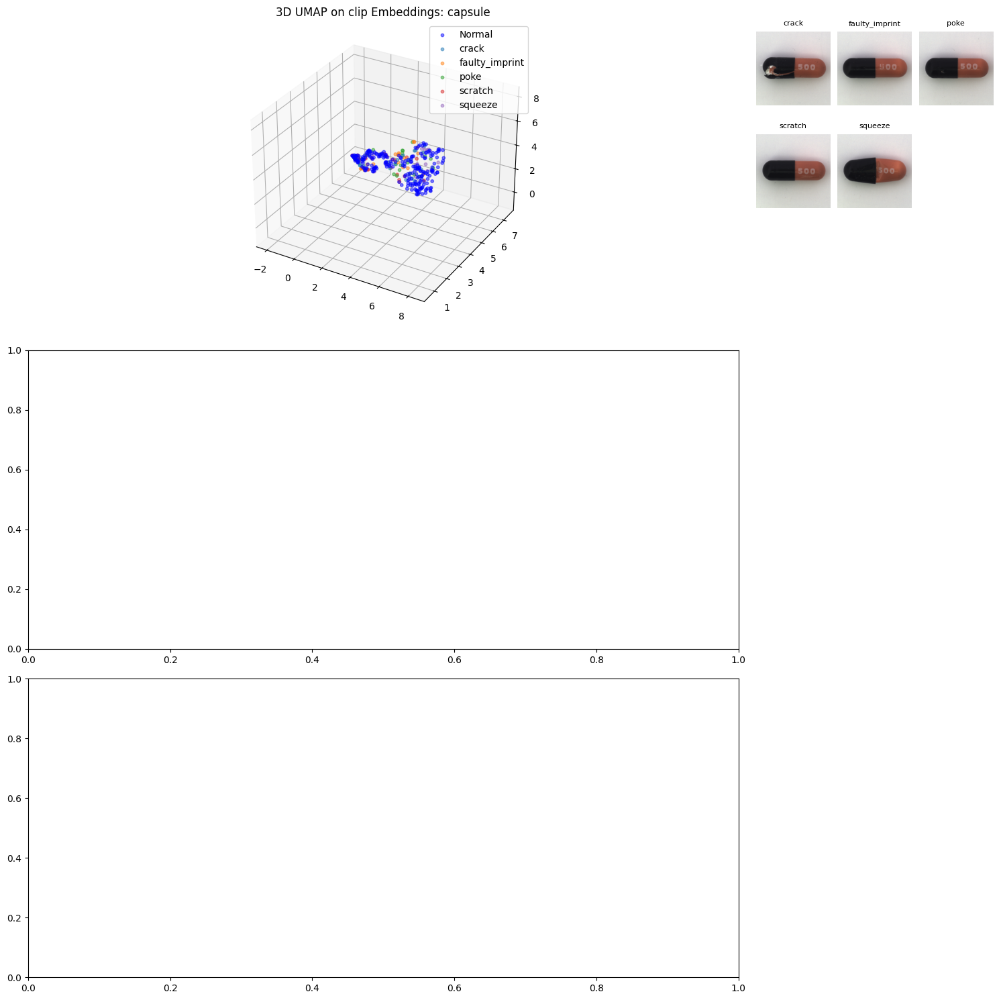

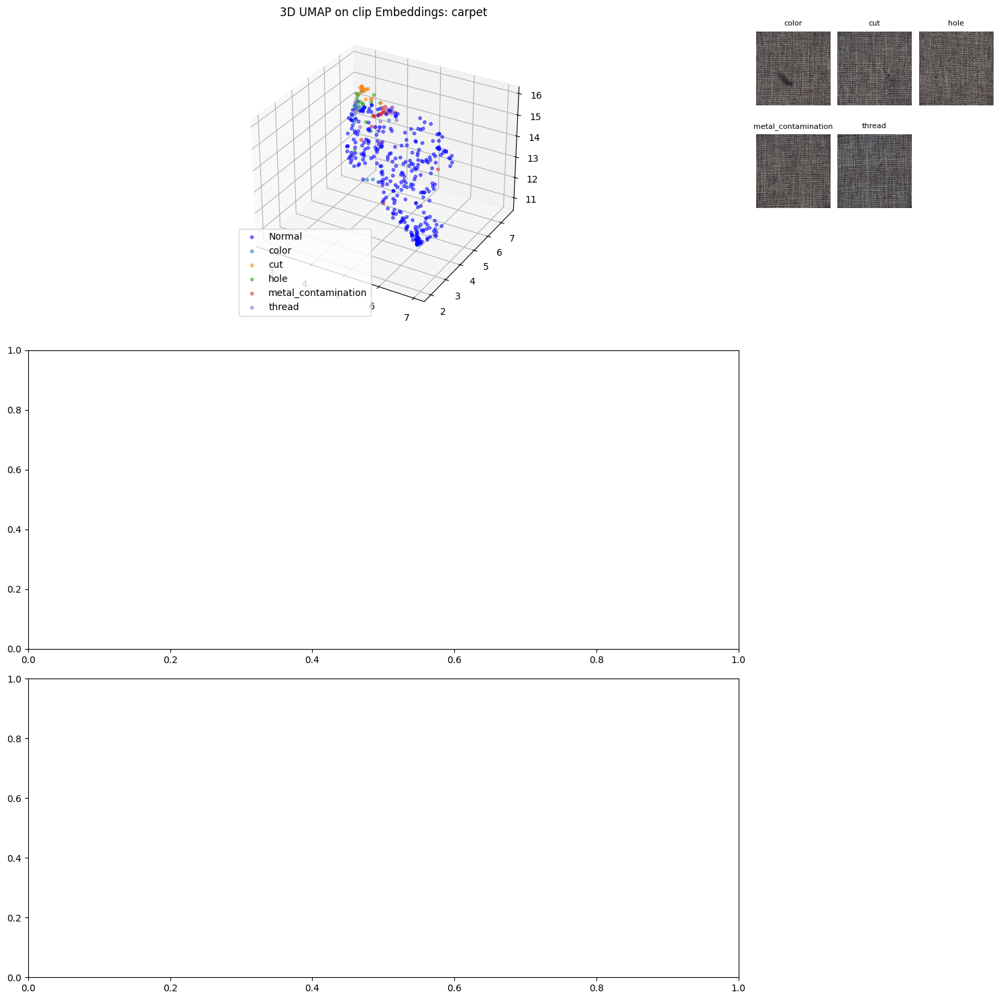

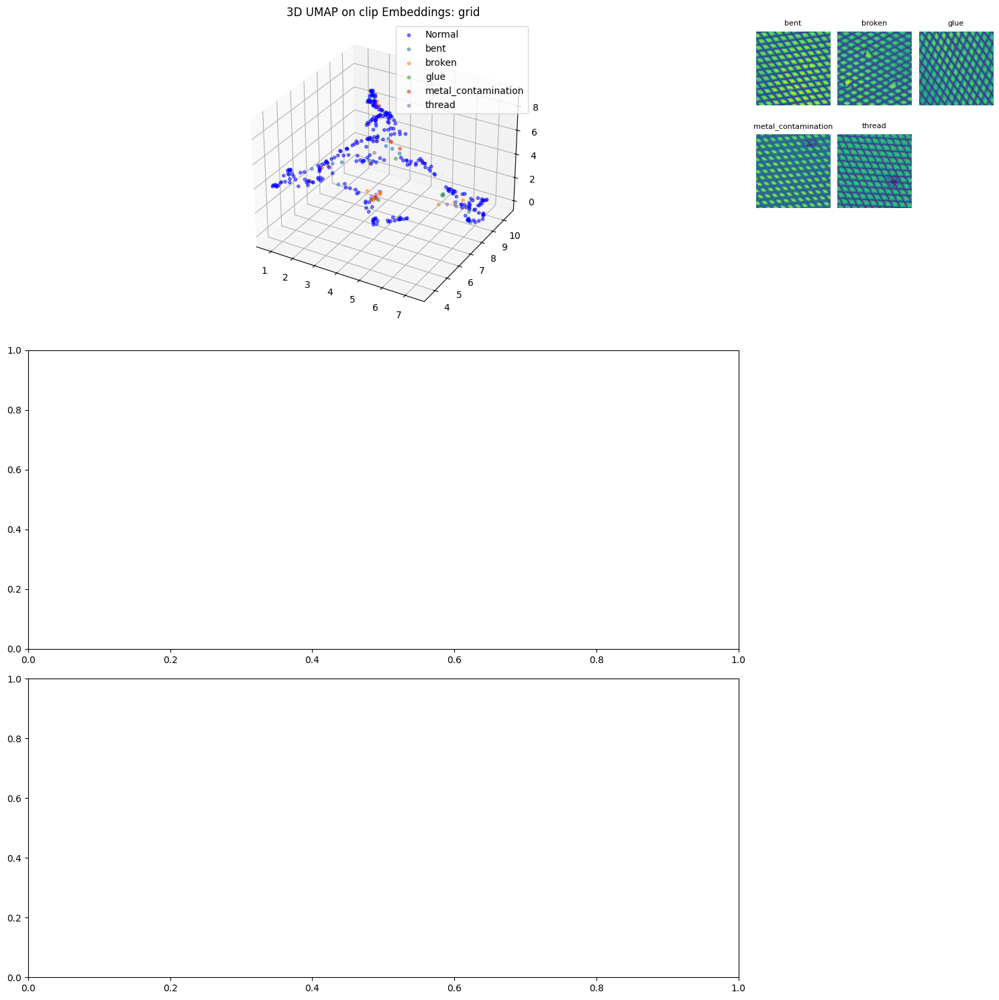

...

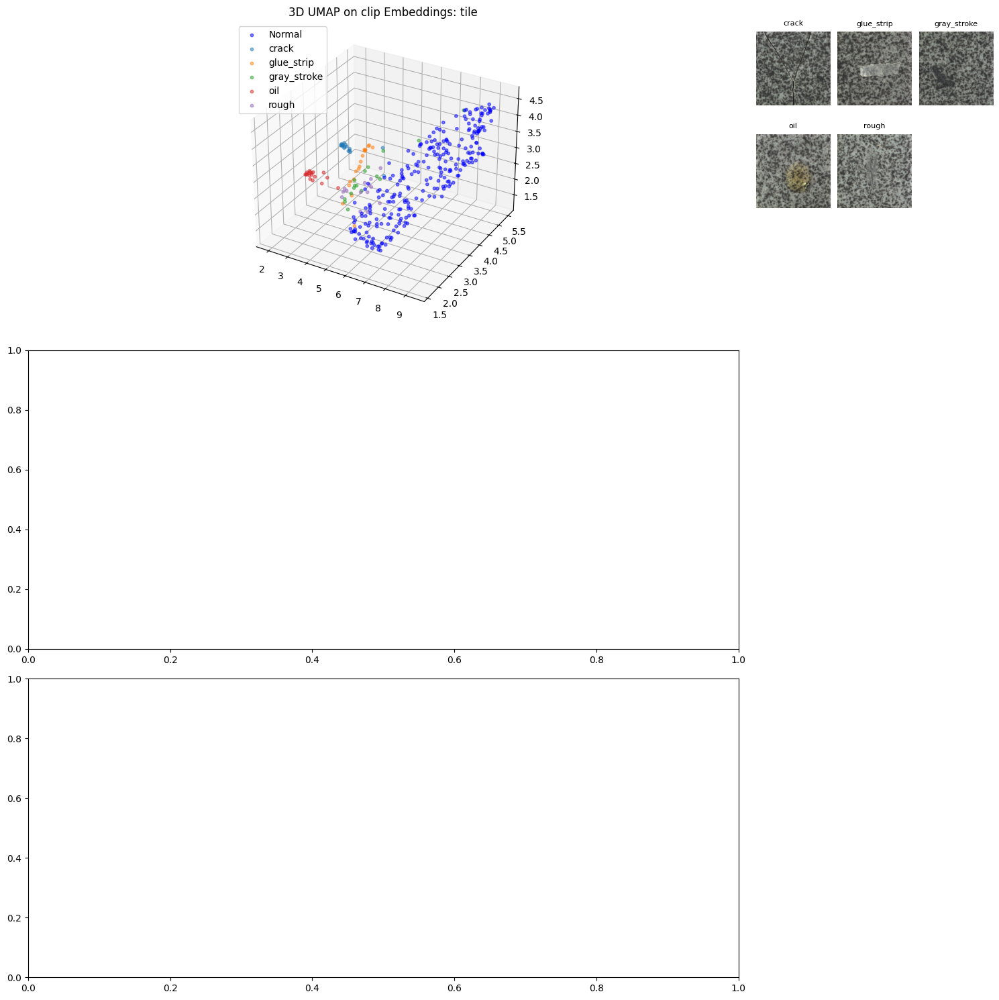

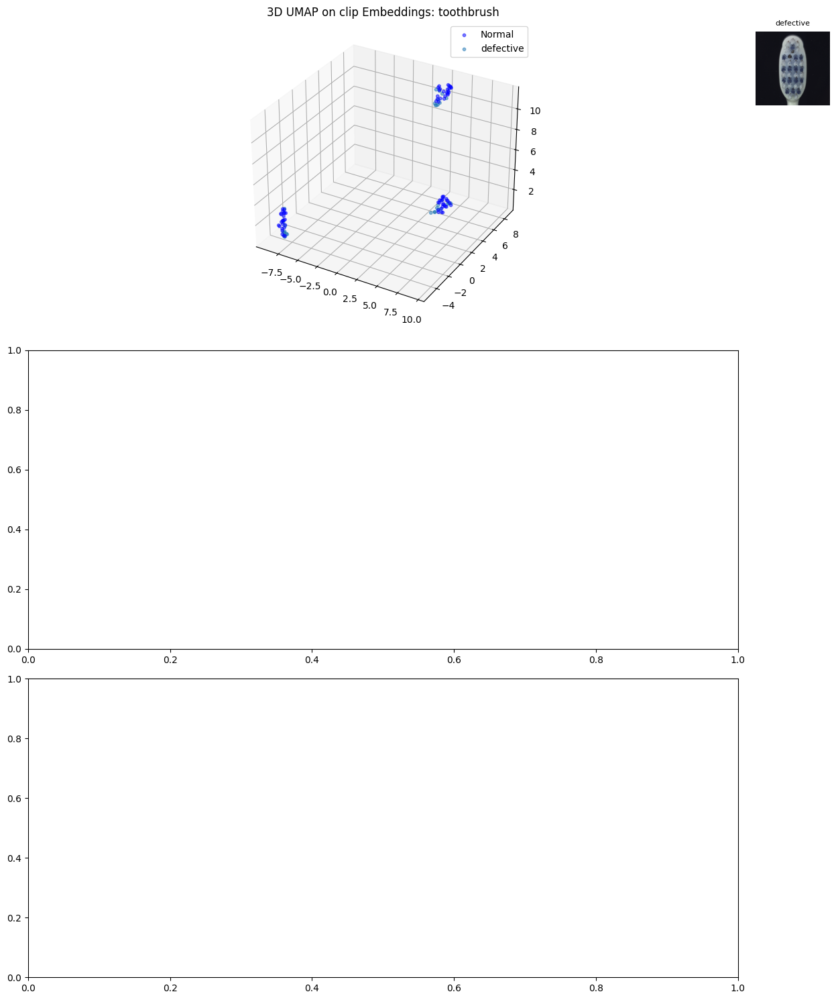

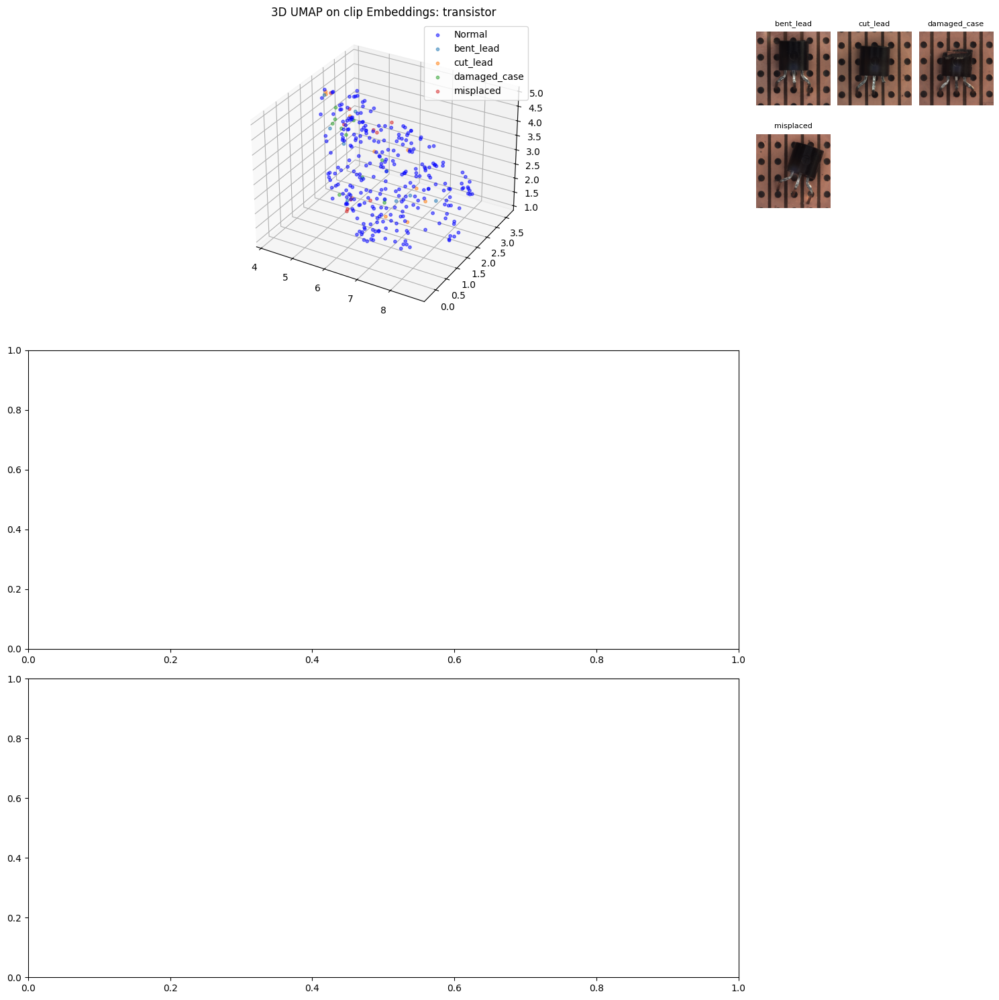

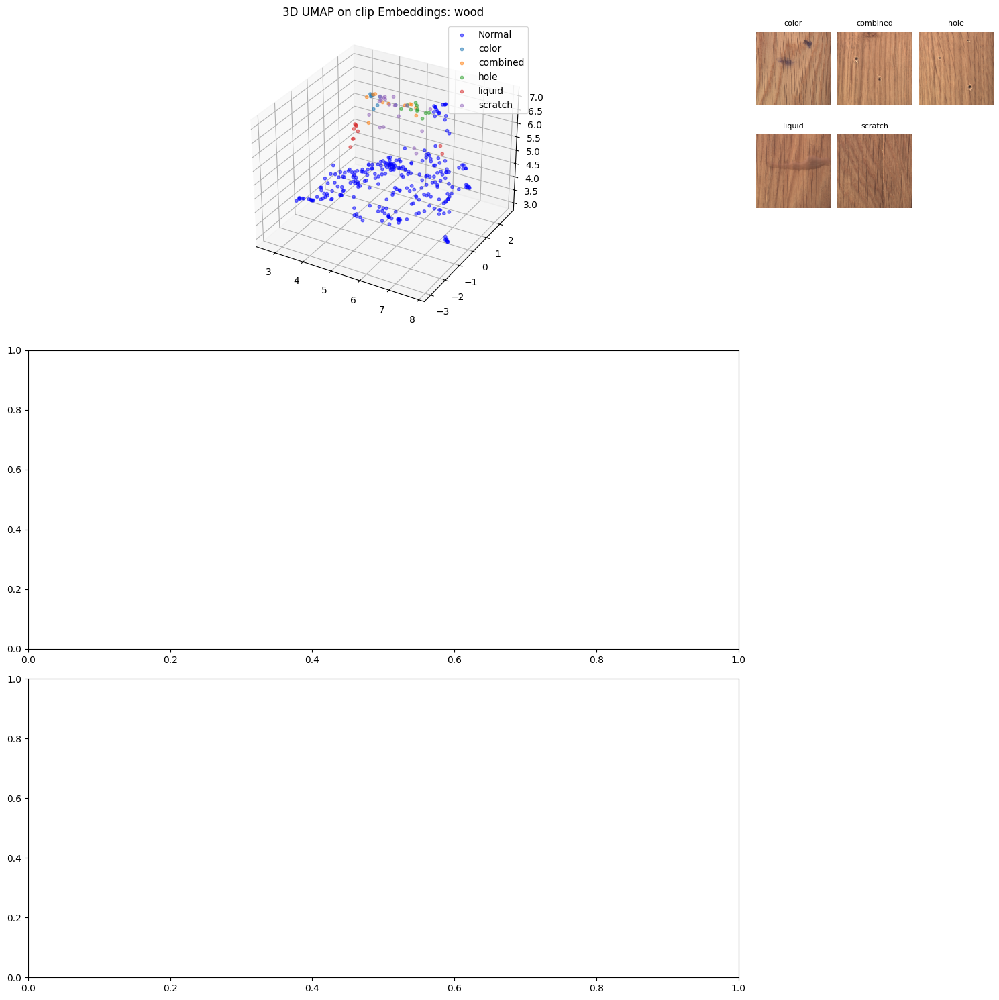

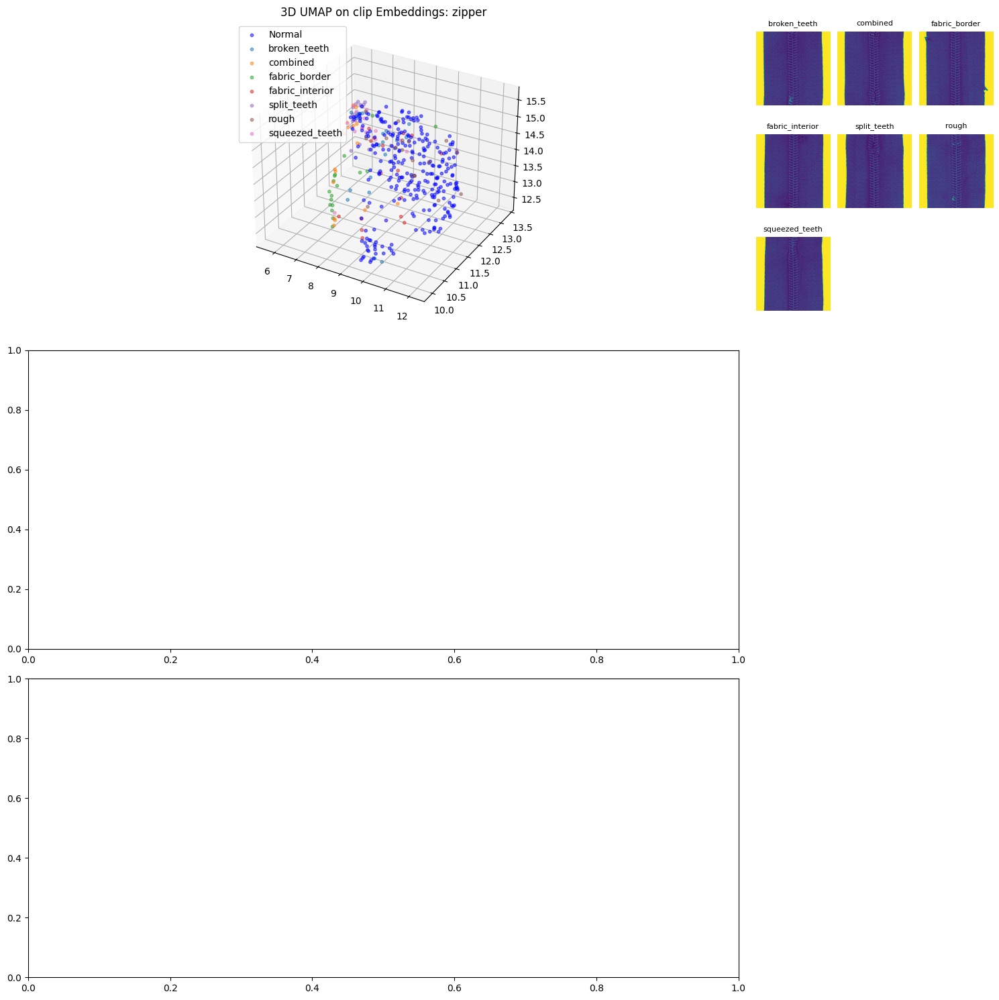

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from mpl_toolkits.mplot3d import Axes3D  # Import the 3D plotting toolkit
from matplotlib.gridspec import GridSpec, GridSpecFromSubplotSpec
import seaborn as sns
import umap

# Assuming df, anomaly_categories are already defined

for category in list(anomaly_categories.keys()):
    # Filter for category
    df_category = df[df.index.str.contains(category)]
    
    # Convert the resulting series of lists to a NumPy array
    numpy_array = df_category.to_numpy()

    # Apply UMAP to reduce the dimensionality to 3D
    reducer = umap.UMAP(n_components=3)
    umap_embeddings = reducer.fit_transform(numpy_array)
    
    # Filter for anomaly and normal
    df_category_anomaly = df_category[~df_category.index.str.contains('good')]
    df_category_normal = df_category[df_category.index.str.contains('good')]
    
    # Create figure and GridSpec layout
    fig = plt.figure(figsize=(15, 15))
    gs = GridSpec(3, 2, figure=fig, height_ratios=[1, 1, 1], width_ratios=[3, 1])
    
    # 3D UMAP plot
    ax_umap = fig.add_subplot(gs[0, 0], projection='3d')
    
    # Anomaly and Normal boxplot axes
    ax_anomaly = fig.add_subplot(gs[1, 0])
    ax_normal = fig.add_subplot(gs[2, 0])
    
    # Inner grid for sample images
    inner_gs = GridSpecFromSubplotSpec(3, 3, subplot_spec=gs[0, 1], wspace=0.1, hspace=0.1)

    # Define the color palette
    palette = sns.color_palette('tab10', len(anomaly_categories[category]) + 1)

    # Index of normal samples
    idx = df_category.index.str.contains('good')
    anomaly_subclasses_idx = [df_category.index.str.contains(sub) for sub in anomaly_categories[category]]
    anomaly_subclasses_paths = {sub:df_category[df_category.index.str.contains(sub)].index[0] for sub in anomaly_categories[category]}

    # Plot normal samples
    ax_umap.scatter(umap_embeddings[idx, 0], umap_embeddings[idx, 1], umap_embeddings[idx, 2], s=10, alpha=0.5, color='blue', label='Normal')

    # Plot each type of anomaly
    for i, sub_idx in enumerate(anomaly_subclasses_idx):
        ax_umap.scatter(umap_embeddings[sub_idx, 0], umap_embeddings[sub_idx, 1], umap_embeddings[sub_idx, 2], s=10, alpha=0.5, color=palette[i], label=anomaly_categories[category][i])

    ax_umap.set_title(f'3D UMAP on clip Embeddings: {category}')
    ax_umap.legend()

    # Uncomment below for boxplots
    # sns.boxplot(data=df_category_anomaly, ax=ax_anomaly, linewidth=0.9, fliersize=0.05)
    # ax_anomaly.set_ylim(-1.5, 1.5)
    # ax_anomaly.set_title(f" {category}: Anomaly")
    # ax_anomaly.set_xticks([])

    # sns.boxplot(data=df_category_normal, ax=ax_normal, linewidth=0.9, fliersize=0.05)
    # ax_normal.set_ylim(-1.5, 1.5)
    # ax_normal.set_title(f" {category}: Normal")
    # ax_normal.set_xticks([])

    # Plot each sample image for anomaly categories
    for i, anomaly in enumerate(anomaly_categories[category]):
        ax_image = fig.add_subplot(inner_gs[i])
        img = mpimg.imread(anomaly_subclasses_paths[anomaly])
        ax_image.imshow(img)
        ax_image.axis('off')
        ax_image.set_title(anomaly, fontsize=8)

    plt.tight_layout()
    plt.show()
